# SpatialDE on Split-FISH data

`base.py` and `util.py` and are from the SpatialDE repository.
- `base.py` contains all that is needed for SpatialDE p-value analysis
- `util.py` converts p-values to q-values, which correspond to the fraction of signficant callouts that are expected to be falsely detected

`plot_utils.py` was added as an additonal plotting function to visualize distributios of any number of genes

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

from mpl_toolkits.axes_grid1.inset_locator import inset_axes

mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False

sns.set(style = 'white', 
        context = 'notebook', 
        font_scale = 0.8, 
        rc = {'figure.figsize' : (6,5), 
            "figure.dpi" : 120 }
       )

def ticklabels_as_percent():
    gca().set_xticklabels([f"{x*100:.0f}%" for x in gca().get_xticks()])

## Read and parse hdf5 coordinates file

Choose coordinate file to use

In [2]:
# ovary
# hdf5_file = "coords_combined_merged_iter_0__20200204_1029.hdf5"

# liver
#hdf5_file = "/home/ubuntu/unsegmented_spaDE_forjinyue/B4/20200221_WK_T1_B4_40_12/output_40/coords_smfishmerfish_merged.hdf5"
hdf5_file = '/content/coords_smfishmerfish_merged.hdf5'

# brain
# hdf5_file = "coords_combined_merged_iter_0__20200131_1317.hdf5"

#hdf5_file = "coords_combined_merged_iter_0__20200203_1701.hdf5"

- read the hdf5 coordinates file
- get the maximum extent of the spot coordinates

In [3]:
import h5py

def read_coord_file(h5file, verbose:bool = True):

    with h5py.File(h5file, 'r') as f:

        # print a list of the keys
        gene_list = list(f.keys())
        if verbose:
            print(f"\nKeys:\n {gene_list}\n\n")

        minmax_coords = np.zeros((len(gene_list),4))

        for gene_index, gene in enumerate(f):

            if verbose:
                print("-" * 50 + f"\n{gene}\n" + "-" * 50 + "\n")

                # print attributes if present
                gene_info = f[gene].attrs
                print(f"Attributes:")
                if len(gene_info) < 1:
                    print("no attributes")
                else:
                    for attribute in gene_info:
                        print(f"  - {attribute} : {gene_info[attribute]}")

                # print the data array with properties
                print(f"\nShape = {f[gene].shape}\n"
                      f"Type = {f[gene].dtype}\n"
                      f"\nArray for {f[gene]}:\n\n"
                      #f"{np.array(f[gene])}\n"
                     )

            min_y = np.min(f[gene][:,1])
            max_y = np.max(f[gene][:,1])

            min_x = np.min(f[gene][:,2])
            max_x = np.max(f[gene][:,2])

            minmax_coords[gene_index,:] = np.array((min_y,max_y,min_x,max_x))
        
    minmax_global = (np.min(minmax_coords[:,0]), np.max(minmax_coords[:,1]),
                     np.min(minmax_coords[:,2]), np.max(minmax_coords[:,3]))

    return minmax_global, minmax_coords, gene_list

minmax_global, _ , gene_list = read_coord_file(hdf5_file, verbose = False)
print("minumum and maximum coordinate positions:", minmax_global,"\n\nGenes:\n", gene_list)

minumum and maximum coordinate positions: (37.220000000000255, 12852.12, 242.92666666666506, 14868.32) 

Genes:
 ['ABCC4', 'ABLIM1', 'AC067773.1', 'AC136759.1', 'AC139491.5', 'AC244197.3', 'ACHE', 'ADAMTS18', 'ADCY3', 'ADCYAP1R1', 'ADGRB3', 'ADGRL2', 'AGAP2', 'AGAP2a', 'AGO1', 'AHDC1', 'AHI1', 'AKAP9', 'AL035425.3', 'AL139099.1', 'ANO3', 'AP2S1', 'AQP4-AS1', 'ARC', 'ARHGAP26', 'ARHGAP32', 'ARID1B', 'ARPP19', 'ARPP21', 'ASAP2', 'ASCC1', 'ASCL1', 'ASPM', 'ASTN2', 'ATP10A', 'ATP1B1', 'AUTS2', 'B3GAT2', 'BARHL2', 'BAZ2B', 'BCL11A', 'BCL11B', 'BDP1', 'BMERB1', 'BMPR1B', 'BRINP3', 'Blank-1', 'Blank-10', 'Blank-11', 'Blank-12', 'Blank-13', 'Blank-14', 'Blank-15', 'Blank-16', 'Blank-17', 'Blank-18', 'Blank-19', 'Blank-2', 'Blank-20', 'Blank-21', 'Blank-22', 'Blank-23', 'Blank-24', 'Blank-25', 'Blank-26', 'Blank-27', 'Blank-28', 'Blank-29', 'Blank-3', 'Blank-30', 'Blank-31', 'Blank-32', 'Blank-33', 'Blank-34', 'Blank-35', 'Blank-36', 'Blank-37', 'Blank-38', 'Blank-39', 'Blank-4', 'Blank-40', 'B

get the coordinates of the bin **edges** and **centres**

- `bin_size` can be set. too small might result in too many locations, but too large will not be able to detect small lenth-scale changes

In [4]:
def roundUp(num, increment): 
    if num % increment != 0.:
        return num - num % increment + increment
    else:
        return num
    
def roundDown(num, increment):
    if num % increment != 0.:
        return num - num % increment - increment
    else:
        return num
    
# Set number of pixels for each bin (Y, X)
# ----------------------------------------
bin_size = 150, 150

minmax_expanded = (roundDown(minmax_global[0], bin_size[0]), roundUp(minmax_global[1], bin_size[0]),
                   roundDown(minmax_global[2], bin_size[1]), roundUp(minmax_global[3], bin_size[1]),)

bin_edges_y = np.arange(minmax_expanded[0], minmax_expanded[1]+1, bin_size[0])
bin_edges_x = np.arange(minmax_expanded[2], minmax_expanded[3]+1, bin_size[1])

bin_coords_y = (bin_edges_y[1:] + bin_edges_y[:-1])/2
bin_coords_x = (bin_edges_x[1:] + bin_edges_x[:-1])/2

print("adjusted minumum and maximum coordinate positions:", minmax_expanded)
print("\nEdges:\nY\n",bin_edges_y,"\n X\n", bin_edges_x)
print("\nCentres:\nY\n",bin_coords_y,"\n X\n", bin_coords_x)

adjusted minumum and maximum coordinate positions: (-150.0, 12900.0, 0.0, 15000.0)

Edges:
Y
 [ -150.     0.   150.   300.   450.   600.   750.   900.  1050.  1200.
  1350.  1500.  1650.  1800.  1950.  2100.  2250.  2400.  2550.  2700.
  2850.  3000.  3150.  3300.  3450.  3600.  3750.  3900.  4050.  4200.
  4350.  4500.  4650.  4800.  4950.  5100.  5250.  5400.  5550.  5700.
  5850.  6000.  6150.  6300.  6450.  6600.  6750.  6900.  7050.  7200.
  7350.  7500.  7650.  7800.  7950.  8100.  8250.  8400.  8550.  8700.
  8850.  9000.  9150.  9300.  9450.  9600.  9750.  9900. 10050. 10200.
 10350. 10500. 10650. 10800. 10950. 11100. 11250. 11400. 11550. 11700.
 11850. 12000. 12150. 12300. 12450. 12600. 12750. 12900.] 
 X
 [    0.   150.   300.   450.   600.   750.   900.  1050.  1200.  1350.
  1500.  1650.  1800.  1950.  2100.  2250.  2400.  2550.  2700.  2850.
  3000.  3150.  3300.  3450.  3600.  3750.  3900.  4050.  4200.  4350.
  4500.  4650.  4800.  4950.  5100.  5250.  5400.  5550.  5700

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


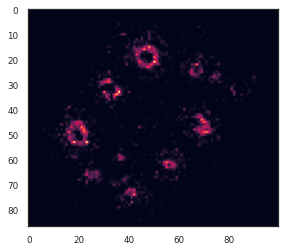

In [5]:
binned_counts_bygene = {}

with h5py.File(hdf5_file, 'r') as f:
    
    for gene in gene_list:
        
        if f[gene].ndim == 2:
            binned_counts = np.histogram2d(
                f[gene][:, 1], f[gene][:, 2],
                bins=[bin_edges_y, bin_edges_x],
                )[0]
            binned_counts_bygene[gene] = binned_counts
            
        else:
            binned_counts_bygene[gene] = np.zeros((len(bin_coords_y), len(bin_coords_x)))

test_gene = "ASPM"
print(binned_counts_bygene[test_gene])
plt.imshow(binned_counts_bygene[test_gene])

Create the **DataFrame** from **coordinate positions** and **gene counts** for every gene.

- `cell_count_cutoff` can be set. Will remove cells with total gene counts less than this number

In [6]:
all_coords = np.meshgrid(bin_coords_x, bin_coords_y)

data_dict = {"X":all_coords[0].flat, "Y":all_coords[1].flat}
for gene in gene_list:
    data_dict[gene] = binned_counts_bygene[gene].flat

df_raw = pd.DataFrame.from_dict(data_dict)
print("\n---- DataFrame -----")
display(df_raw)


#print("\n---- DataFrame (counts only) -----")
#display(df_counts_raw)

# set cutoff for total counts
cell_count_cutoff = 5

df_counts_raw = df_raw.loc[:,gene_list[0]:]
df_counts_raw = df_counts_raw[df_counts_raw.sum(axis=1) > cell_count_cutoff]
df = df_raw.loc[df_counts_raw.index,:]
print("\n---- Filtered DataFrame -----")
display(df)

df_counts = df.loc[:,gene_list[0]:].copy()
#print("\n---- Filtered DataFrame (counts only) -----")
#display(df_counts_raw)


---- DataFrame -----


,X,Y,ABCC4,ABLIM1,AC067773.1,AC136759.1,AC139491.5,AC244197.3,ACHE,ADAMTS18,ADCY3,ADCYAP1R1,ADGRB3,ADGRL2,AGAP2,AGAP2a,AGO1,AHDC1,AHI1,AKAP9,AL035425.3,AL139099.1,ANO3,AP2S1,AQP4-AS1,ARC,ARHGAP26,ARHGAP32,ARID1B,ARPP19,ARPP21,ASAP2,ASCC1,ASCL1,ASPM,ASTN2,ATP10A,ATP1B1,AUTS2,B3GAT2,...,TPBG,TPX2,TRAF3,TRMT9B,TRPC6,TSC2,TSPAN6,TTC38,TTF2,TTK,TUBB,TUBB3,UBA6-AS1,UNC13B,UNC5C,USP34,USP45,USP7,VAMP1,VAT1L,VIM,VIP,VSTM2L,VWA8,VWC2L,WDFY3,WDR60,WNT2B,WNT3,WNT4,XIST,ZBTB20,ZBTB44,ZDHHC21,ZEB2,ZFYVE28,ZNF439,ZNF714,ZNF804A,ZNF90
0,75.0,-75.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,225.0,-75.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,375.0,-75.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,525.0,-75.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,675.0,-75.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8695,14325.0,12825.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8696,14475.0,12825.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8697,14625.0,12825.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8698,14775.0,12825.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



---- Filtered DataFrame -----


,X,Y,ABCC4,ABLIM1,AC067773.1,AC136759.1,AC139491.5,AC244197.3,ACHE,ADAMTS18,ADCY3,ADCYAP1R1,ADGRB3,ADGRL2,AGAP2,AGAP2a,AGO1,AHDC1,AHI1,AKAP9,AL035425.3,AL139099.1,ANO3,AP2S1,AQP4-AS1,ARC,ARHGAP26,ARHGAP32,ARID1B,ARPP19,ARPP21,ASAP2,ASCC1,ASCL1,ASPM,ASTN2,ATP10A,ATP1B1,AUTS2,B3GAT2,...,TPBG,TPX2,TRAF3,TRMT9B,TRPC6,TSC2,TSPAN6,TTC38,TTF2,TTK,TUBB,TUBB3,UBA6-AS1,UNC13B,UNC5C,USP34,USP45,USP7,VAMP1,VAT1L,VIM,VIP,VSTM2L,VWA8,VWC2L,WDFY3,WDR60,WNT2B,WNT3,WNT4,XIST,ZBTB20,ZBTB44,ZDHHC21,ZEB2,ZFYVE28,ZNF439,ZNF714,ZNF804A,ZNF90
242,6375.0,225.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
243,6525.0,225.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0
244,6675.0,225.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,17.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0
245,6825.0,225.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,6.0,18.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
246,6975.0,225.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8541,6225.0,12675.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8542,6375.0,12675.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8543,6525.0,12675.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,14.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8544,6675.0,12675.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Plot histogram of counts, per gene and per cell


__ Total counts per gene __:
ABCC4         1077.0
ABLIM1         232.0
AC067773.1      96.0
AC136759.1      28.0
AC139491.5     187.0
               ...  
ZFYVE28        211.0
ZNF439        1127.0
ZNF714        1019.0
ZNF804A        103.0
ZNF90          498.0
Length: 610, dtype: float64

Lowest count (per gene): 14.0
Highest count (per gene): 147289.0

__ Total counts per cell __:
242       6.0
243      89.0
244     123.0
245     124.0
246      89.0
        ...  
8541     20.0
8542     25.0
8543     74.0
8544     34.0
8545      7.0
Length: 5262, dtype: float64

Lowest count (per gene): 6.0
Highest count (per gene): 742.0

Number of cells with no counts: 0



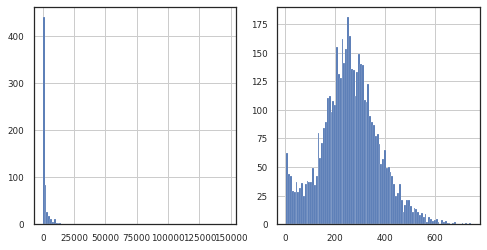

In [7]:
total_counts_pergene = df_counts.sum(axis = 0)
max_total_pergene = total_counts_pergene.max()
min_total_pergene = total_counts_pergene.min()

print(
    f"__ Total counts per gene __:\n{total_counts_pergene}\n\n"
    f"Lowest count (per gene): {min_total_pergene}\n"
    f"Highest count (per gene): {max_total_pergene}\n"
)

total_counts_percell = df_counts.sum(axis = 1)
max_total_percell = total_counts_percell.max()
min_total_percell = total_counts_percell.min()
# number of cells with no counts
num_zerocount = np.sum(total_counts_percell == 0.)

print(
    f"__ Total counts per cell __:\n{total_counts_percell}\n\n"
    f"Lowest count (per gene): {min_total_percell}\n"
    f"Highest count (per gene): {max_total_percell}\n"
    f"\nNumber of cells with no counts: {num_zerocount}\n"
)

# plot histogram
# --------------

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (8.0, 4.0))

total_counts_pergene.hist(bins=100, ax = ax[0], linewidth = 0.2)
total_counts_percell.hist(bins=100, ax = ax[1], linewidth = 0.2)

## Preprocess counts

- Normalize data either to median total count or a fixed value
- *optional* use `NaiveDE`'s stablilize function (log of counts + phi)

Then update merged dataframe with **processed** counts

In [8]:
def stabilize(expression_matrix):
    ''' Use Anscombes approximation to variance stabilize Negative Binomial data
    See https://f1000research.com/posters/4-1041 for motivation.
    Assumes columns are samples, and rows are genes
    
    From NaiveDE library from oliver stegle's lab
    '''
    from scipy import optimize
    phi_hat, _ = optimize.curve_fit(
        lambda mu, phi: mu + phi * mu ** 2, 
        expression_matrix.mean(1), 
        expression_matrix.var(1)
    )

    return np.log(expression_matrix + 1. / (2 * phi_hat[0]))


# decide what value to normalize to, whether to use stablilize function
# ---------------------------------------------------------------------
use_median = True
# normalize_to = 1000
to_stabilize = True

if use_median:
    median_percell_counts = total_counts_percell.median()
    print(f"Median total counts per cell: {median_percell_counts}\n")
    normalize_to = median_percell_counts

counts_normalized = df_counts.divide(total_counts_percell, axis = 0) * normalize_to

# check if we normalized correctly
check_sum = counts_normalized.sum(axis=1)
print(
    f"sum of normalized dataframe:\n{check_sum}\n\n"
    f"max = {check_sum.max()}, min = {check_sum.min()}\n"
)

if to_stabilize:
    counts_processed = stabilize(counts_normalized.T).T
    print("\n--- Stabilized counts: ---")
else:
    counts_processed = counts_normalized
    print("\n--- Normalized counts: ---")

df.loc[:, gene_list[0]:] = counts_processed    
display(df)

Median total counts per cell: 258.0

sum of normalized dataframe:
242     258.0
243     258.0
244     258.0
245     258.0
246     258.0
        ...  
8541    258.0
8542    258.0
8543    258.0
8544    258.0
8545    258.0
Length: 5262, dtype: float64

max = 258.0000000000001, min = 257.99999999999994


--- Stabilized counts: ---


,X,Y,ABCC4,ABLIM1,AC067773.1,AC136759.1,AC139491.5,AC244197.3,ACHE,ADAMTS18,ADCY3,ADCYAP1R1,ADGRB3,ADGRL2,AGAP2,AGAP2a,AGO1,AHDC1,AHI1,AKAP9,AL035425.3,AL139099.1,ANO3,AP2S1,AQP4-AS1,ARC,ARHGAP26,ARHGAP32,ARID1B,ARPP19,ARPP21,ASAP2,ASCC1,ASCL1,ASPM,ASTN2,ATP10A,ATP1B1,AUTS2,B3GAT2,...,TPBG,TPX2,TRAF3,TRMT9B,TRPC6,TSC2,TSPAN6,TTC38,TTF2,TTK,TUBB,TUBB3,UBA6-AS1,UNC13B,UNC5C,USP34,USP45,USP7,VAMP1,VAT1L,VIM,VIP,VSTM2L,VWA8,VWC2L,WDFY3,WDR60,WNT2B,WNT3,WNT4,XIST,ZBTB20,ZBTB44,ZDHHC21,ZEB2,ZFYVE28,ZNF439,ZNF714,ZNF804A,ZNF90
242,6375.0,225.0,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,...,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,4.895428,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691
243,6525.0,225.0,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.348983,1.542691,...,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.348983,3.675381,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.024990,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.348983,1.542691,1.542691,1.542691,1.542691,1.542691
244,6675.0,225.0,1.913198,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.913198,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.913198,1.542691,1.542691,1.913198,1.542691,...,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,3.396114,3.697237,1.542691,1.542691,1.542691,1.913198,1.542691,1.542691,1.542691,1.542691,2.182932,1.542691,1.542691,1.542691,1.542691,2.182932,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.182932,1.542691,1.913198,1.542691,1.542691,1.542691
245,6825.0,225.0,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.910698,1.542691,1.910698,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.910698,1.542691,...,1.542691,1.542691,1.542691,1.542691,1.542691,1.910698,1.542691,1.542691,1.542691,1.542691,2.842641,3.740731,1.542691,1.910698,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.910698,1.910698,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691
246,6975.0,225.0,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.024990,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,...,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.789487,3.426444,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,1.542691,2.348983,1.542691,1.542691,1.542691,1.5

## View location coordinates (and crop out a region)

- Plot the cell locations using the `X` and `Y` columns of the DataFrame
- If cropping, regions should be given as `(y_lower, y_upper, x_lower, x_upper)`
- plot the counts for 1 gene to tes

Text(0.5, 1.0, 'ASPM counts')

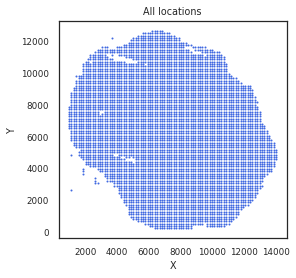

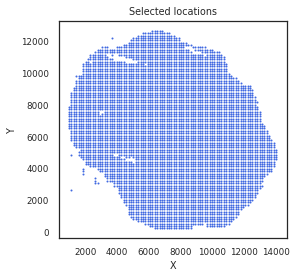

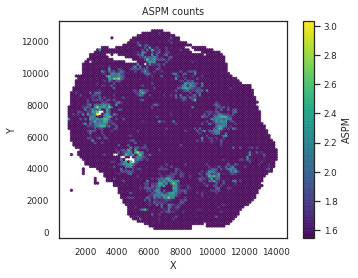

In [9]:
# Plot all locations
# ------------------

fig, ax = plt.subplots()
df.plot(x='X', y='Y', kind="scatter", s=1, c="royalblue", ax=ax)
ax.set_aspect('equal', adjustable='box')
ax.set_title("All locations")

# (optional) crop
# ---------------

to_crop = False

if to_crop:
    region = (0, 10000, 0, 12000)
    df = df[df["Y"].between(region[0],region[1]) & df["X"].between(region[2],region[3])]
    display(df)
else:
    pass

fig, ax = plt.subplots()
df.plot(x='X', y='Y', kind="scatter", s=1, c="royalblue", ax=ax)
ax.set_aspect('equal', adjustable='box')
ax.set_title("Selected locations")

# Plot counts of 1 gene to test
# -----------------------------

fig,ax = plt.subplots()
df.plot.scatter(x="X", y="Y", s=5, c=test_gene, alpha = 0.8, colormap='viridis', ax=ax)
ax.set_aspect('equal', adjustable='box')
ax.set_title(f"{test_gene} counts")

Plot a few genes to check

- Choose a list of favourite genes or just plot the first few in the dataframe.

- **Note:** This is where we import the plotting function for displaying distributions of counts for each gene.

Number of genes: 5
Plots per row: 4
Number of rows: 2


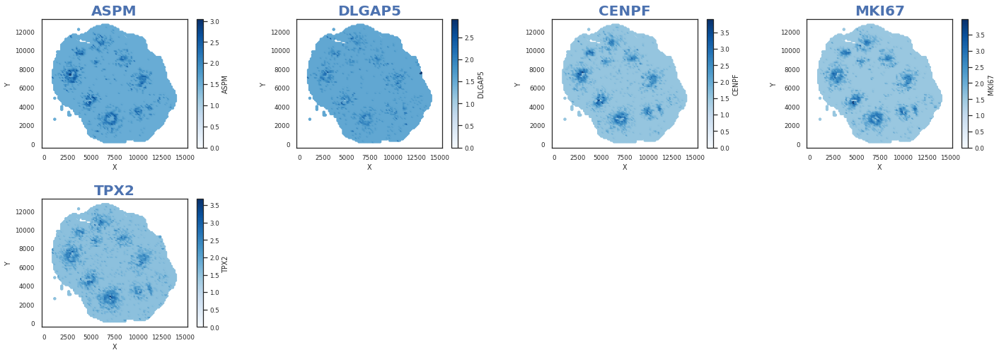

Number of genes: 6
Plots per row: 4
Number of rows: 2


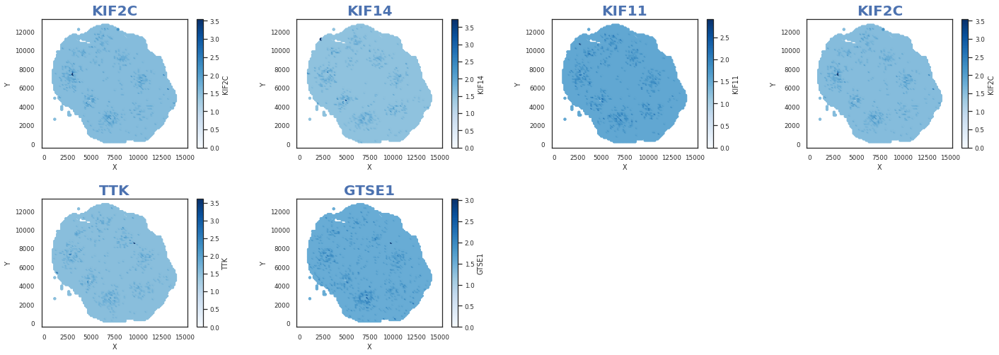

Number of genes: 3
Plots per row: 4
Number of rows: 1


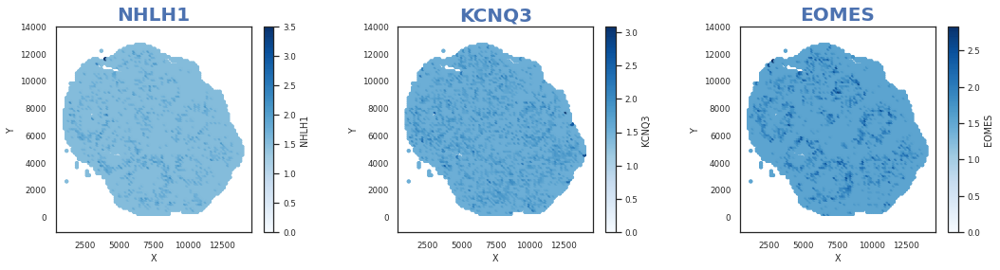

In [10]:
from plot_utils import plot_genes

# kidney from paper
selected_genes1 = ["ASPM","DLGAP5","CENPF","MKI67","TPX2"]
selected_genes2 = ["KIF2C","KIF14","KIF11","KIF2C","TTK","GTSE1"]
selected_genes3 = ["NHLH1", "KCNQ3","EOMES"]
genes_to_plot1 = [gene for gene in selected_genes1 if gene in gene_list]
genes_to_plot2 = [gene for gene in selected_genes2 if gene in gene_list]
genes_to_plot3 = [gene for gene in selected_genes3 if gene in gene_list]
'''
if len(genes_to_plot1) == 0:
    genes_to_plot1 = gene_list[:5]
'''
plot_genes(genes_to_plot1, df, x_colname = "X", y_colname = "Y",colormap = "Blues", vmin = 0, vmax = None)
plot_genes(genes_to_plot2, df, x_colname = "X", y_colname = "Y",colormap = "Blues", vmin = 0, vmax = None)
plot_genes(genes_to_plot3, df, x_colname = "X", y_colname = "Y",colormap = "Blues", vmin = 0, vmax = None)

# Run SpatialDE

This is the main SpatialDE test.

### Set length scales

- First, we set the length scale. We can either use the `get_l_limits` function to get the smallest and largest distances between locations or set this manually if you know the length scale for the problem you're intersted in (e.g. organoid size etc.)
- **Note**: This can be set manually if you know the maximum length scale (e.g. width of a typical neuroepithelial bud)

/content/base.py:26: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  R2 = -2. * np.dot(X, X.T) + (Xsq[:, None] + Xsq[None, :])


smallest distance: 75.0
largest distance: 27634.217919094437
vector of distances:
[   84.34916988   189.72753224   426.7562626    959.90763974
  2159.1310019   4856.55753781 10923.90924738 24571.27138227]



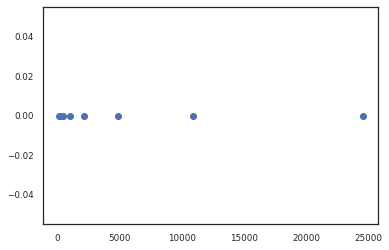

In [11]:
from base import get_l_limits

l_min, l_max = get_l_limits(df[['X', 'Y']])

length_scales = np.logspace(np.log10(l_min/2), np.log10(l_max*2), 10)
length_scales = length_scales[1:-1]
#length_scales = length_scales[2:-2]

plt.scatter(length_scales, np.zeros(length_scales.shape))

print(f"smallest distance: {l_min}\n"
      f"largest distance: {l_max}\n"
      f"vector of distances:\n{length_scales}\n")

**Run SpaitalDE.** Code below comes from base `run` function.

In [12]:
%%time

from scipy.stats import chi2
from base import dyn_de, get_mll_results
from util import qvalue

kernel_space = {"SE": length_scales, "const" : 0}

results = dyn_de(df[['X', 'Y']], df.loc[:,gene_list[0]:], kernel_space)
display(results)

# show just the first gene
results_firstgene = results[results["g"] == gene_list[0]]
print(f"Entries for gene: {gene_list[0]}")
display(results_firstgene)

/content/base.py:40: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  R2 = -2. * np.dot(X, X.T) + (Xsq[:, None] + Xsq[None, :])


,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC
0,NaN,2,ABCC4,NaN,inf,4696.251107,1.578617,0.000000e+00,const,5262,NaN,NaN,0.000000,-9375.365680
1,NaN,2,ABLIM1,NaN,inf,8857.316294,1.550890,0.000000e+00,const,5262,NaN,NaN,0.000000,-17697.496055
2,NaN,2,AC067773.1,NaN,inf,11831.040118,1.545938,0.000000e+00,const,5262,NaN,NaN,0.000000,-23644.943702
3,NaN,2,AC136759.1,NaN,inf,15138.483574,1.543632,0.000000e+00,const,5262,NaN,NaN,0.000000,-30259.830615
4,NaN,2,AC139491.5,NaN,inf,9606.095967,1.549268,0.000000e+00,const,5262,NaN,NaN,0.000000,-19195.055401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5485,3.379368e-02,4,ZFYVE28,24571.271382,9.008412e-01,9412.482652,1.571188,2.450855e-03,SE,5262,4.082272e-03,2.972608e+00,0.003753,-18790.692239
5486,1.240346e-02,4,ZNF439,24571.271382,2.508711e+00,4947.415930,1.531307,4.079772e-03,SE,5262,1.549269e-03,7.676053e+00,0.003642,-9860.558794
5487,6.494179e-11,4,ZNF714,24571.271382,4.851652e+08,4840.313915,1.578996,5.158043e-09,SE,5262,1.762738e-10,3.026321e+10,0.009434,-9646.354763
5488,6.494179e-11,4,ZNF804A,24571.271382,4.851652e+08,10603.325003,1.546460,4.931419e-09,SE,5262,1.704617e-10,2.926536e+10,0.004230,-21172.376939


Entries for gene: ABCC4


,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC
0,NaN,2,ABCC4,NaN,inf,4696.251107,1.578617,0.000000,const,5262,NaN,NaN,0.000000,-9375.365680
610,0.507749,4,ABCC4,84.349170,0.969297,4751.797674,1.578680,0.852044,SE,5262,1.028809e-04,0.001928,0.008312,-9469.322283
1220,0.184386,4,ABCC4,189.727532,4.416075,4803.513120,1.578898,0.179655,SE,5262,5.329647e-06,0.000231,0.013156,-9572.753174
1830,0.406057,4,ABCC4,426.756263,1.449788,4880.126682,1.583795,0.060426,SE,5262,5.336859e-05,0.001058,0.005760,-9725.980299
2440,0.940046,4,ABCC4,959.907640,0.061093,4933.190157,1.629934,0.140464,SE,5262,4.700976e-06,0.001207,0.021118,-9832.107248
3050,0.999741,4,ABCC4,2159.131002,0.000213,4882.579171,2.896691,37.235336,SE,5262,5.036608e-10,0.005461,0.006279,-9730.885276
3660,0.360621,4,ABCC4,4856.557538,0.836035,4709.414502,1.499283,0.013044,SE,5262,4.305386e-01,9.168419,0.012055,-9384.555938
4270,0.154866,4,ABCC4,10923.909247,0.782555,4705.628034,1.480564,0.013307,SE,5262,1.071700e-02,0.590934,0.008448,-9376.983003
4880,0.253079,4,ABCC4,24571.271382,0.092989,4700.620902,1.162604,0.105336,SE,5262,2.181937e-02,0.642332,0.018920,-9366.968738


CPU times: user 12min 4s, sys: 1min 13s, total: 13min 17s
Wall time: 7min 15s


Lowest non-zero p-value: 1.06226104426207e-310



,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval
0,5.077491e-01,4,ABCC4,84.349170,9.692966e-01,4751.797674,1.578680,8.520445e-01,SE,5262,1.028809e-04,1.927767e-03,0.008312,-9469.322283,4696.251107,55.546568,9.127105e-14
1,1.843860e-01,4,ABCC4,189.727532,4.416075e+00,4803.513120,1.578898,1.796554e-01,SE,5262,5.329647e-06,2.309224e-04,0.013156,-9572.753174,4696.251107,107.262013,3.900392e-25
2,4.060566e-01,4,ABCC4,426.756263,1.449788e+00,4880.126682,1.583795,6.042604e-02,SE,5262,5.336859e-05,1.057999e-03,0.005760,-9725.980299,4696.251107,183.875576,6.906746e-42
3,9.400457e-01,4,ABCC4,959.907640,6.109337e-02,4933.190157,1.629934,1.404642e-01,SE,5262,4.700976e-06,1.206791e-03,0.021118,-9832.107248,4696.251107,236.939050,1.828718e-53
4,9.997414e-01,4,ABCC4,2159.131002,2.129325e-04,4882.579171,2.896691,3.723534e+01,SE,5262,5.036608e-10,5.460823e-03,0.006279,-9730.885276,4696.251107,186.328065,2.013147e-42
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4875,1.974390e-09,4,ZNF90,959.907640,4.851652e+08,6675.394835,1.560960,5.031741e-09,SE,5262,2.498023e-07,4.639874e+10,0.005016,-13316.516603,6675.394783,0.000052,9.942580e-01
4876,4.716615e-03,4,ZNF90,2159.131002,1.737336e+02,6678.700560,1.560397,2.458959e-03,SE,5262,1.362160e-05,4.521338e-01,0.017948,-13323.128054,6675.394783,3.305777,6.903668e-02
4877,1.359391e-03,4,ZNF90,4856.557538,3.464033e+02,6678.065663,1.560982,8.885938e-04,SE,5262,2.163486e-06,8.525155e-01,0.004518,-13321.858260,6675.394783,2.670880,1.021995e-01
4878,1.053385e-03,4,ZNF90,10923.909247,1.359880e+02,6678.071373,1.560896,5.902203e-04,SE,5262,2.133996e-06,1.398630e+00,0.004891,-13321.869680,6675.394783,2.676590,1.018336e-01


p-values for ASPM
 [7.42840549e-163 7.63196158e-275 7.06515090e-273 2.00800873e-242
 2.53410914e-175 1.31857678e-067 1.32635234e-042 8.53407365e-012]
--- ASPM ---



,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval
256,0.999955,4,ASPM,84.349170,0.000045,2480.736101,1.608754,1.339194,SE,5262,2.051509e-05,7206.078267,0.004413,-4927.199137,1741.164333,739.571769,7.428405e-163
257,0.529404,4,ASPM,189.727532,0.887444,2995.933564,1.606669,0.262501,SE,5262,5.554783e-07,0.000010,0.005016,-5957.594061,1741.164333,1254.769231,7.631962e-275
258,0.456099,4,ASPM,426.756263,1.181970,2986.884790,1.602182,0.070217,SE,5262,5.253523e-06,0.000100,0.004346,-5939.496515,1741.164333,1245.720458,7.065151e-273
259,0.636548,4,ASPM,959.907640,0.546937,2846.759704,1.593131,0.047299,SE,5262,2.611470e-05,0.000553,0.006372,-5659.246342,1741.164333,1105.595371,2.008009e-242
260,0.999708,4,ASPM,2159.131002,0.000240,2538.074604,0.507875,80.656442,SE,5262,3.652173e-10,0.003115,0.005943,-5041.876143,1741.164333,796.910272,2.534109e-175
261,0.998929,4,ASPM,4856.557538,0.000506,2042.989626,6.146355,50.851246,SE,5262,5.295627e-08,0.033580,0.008737,-4051.706186,1741.164333,301.825293,1.318577e-67
262,0.999684,4,ASPM,10923.909247,0.000045,1928.322531,-2.672058,600.623879,SE,5262,1.317093e-08,0.095328,0.003578,-3822.371997,1741.164333,187.158199,1.326352e-42
263,0.998561,4,ASPM,24571.271382,0.000045,1787.803424,-66.134343,643.525610,SE,5262,3.003939e-08,0.010569,0.008051,-3541.333782,1741.164333,46.639091,8.534074e-12


(array([2., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 1.]),
 array([-274.11736382, -268.85639342, -263.59542302, -258.33445261,
        -253.07348221, -247.8125118 , -242.5515414 , -237.290571  ,
        -232.02960059, -226.76863019, -221.50765978, -216.24668938,
        -210.98571897, -205.72474857, -200.46377817, -195.20280776,
        -189.94183736, -184.68086695, -179.41989655, -174.15892614,
        -168.89795574, -163.63698534, -158.37601493, -153.11504453,
        -147.85407412, -142.59310372, -137.33213332, -132.07116291,
        -126.81019251, -121.5492221 , -116.2882517 , -111.02728129,
        -105.76631089, -100.50534049,  -95.24437008,  -89.98339968,
         -84.72242927,  -79.46145887,  -74.20048846,  -68.93951806,
         -63.67854766,  -58.41757725,  -53.15660685,  -47.89563644,
         -42.63466604,  -3

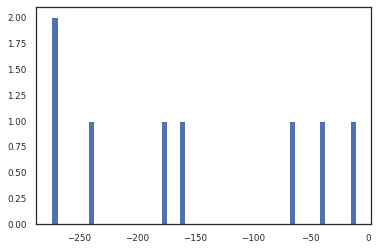

In [13]:
# separate null model from test models
# ------------------------------------


null_model='const'

null_lls = results.query(f"model == '{null_model}'")[['g', 'max_ll']]
model_results = results.query(f"model != '{null_model}'")

model_results = model_results.merge(null_lls, on='g', suffixes=('', '_null'))

# Get log-likelihood ratios, calculate p-values, clip 0 p-values
# --------------------------------------------------------------

model_results['LLR'] = model_results['max_ll'] - model_results['max_ll_null']
model_results['pval'] = chi2.sf(model_results['LLR'], df = 1)

lowest_nonzero_pval = model_results['pval'][model_results['pval'] > 0].min()
print(f"Lowest non-zero p-value: {lowest_nonzero_pval}\n")
model_results['pval'].clip(lower = lowest_nonzero_pval / 2, inplace = True)

display(model_results)

# check the p-values for just 1 gene
# ----------------------------------
print(f"p-values for {test_gene}\n",
      model_results[model_results["g"] == test_gene]["pval"].values)
print(f"--- {test_gene} ---\n",)
display(model_results[model_results["g"] == test_gene])
plt.hist(np.log10(model_results[model_results["g"] == test_gene]["pval"]), bins=50)


### Define Caucy combination rule
Which we will use to combine the p-values from all length scales into a single one.

In [14]:
import mpmath

def cauchy_combo(pvals: np.ndarray,
                 weights = None,
                 verbose:bool = True,
                 ):
    """
    Implement the Cauchy combination rule on an array of p-values to get a combined p-value
    (assumes equal weighting of all variables)
    """
    
    cauchy_vars = np.tan((0.5 - pvals) * np.pi)
    
    if verbose:
        print(f"Cauchy-transformed p-values: {cauchy_vars}\n")
    
    if weights is None:
        cauchy_agg = np.mean(cauchy_vars)
    else:
        assert weights.shape == pvals.shape, (
            "weights array dimension does not match pvals array"
        )
        weights = weights / np.sum(weights)
        if verbose: print(f"Normalized weights: {weights}\n")
        cauchy_agg = np.sum( weights * cauchy_vars )
        
    mpmath.mp.dps = 60
        
    cauchy_agg = mpmath.mp.mpf(cauchy_agg)
    
    if verbose: print(f"aggregated cauchy value: {cauchy_agg}")
    
    return 0.5 - mpmath.atan(cauchy_agg) / mpmath.pi

    
# test cauchy combination function
pvals = np.array([0.8, 0.01, 0.1, 1e-60, 0.005])
weights = np.array([1,1,2,1,1])
print(pvals, weights)

#combo_pval = cauchy_combo(pvals, weights = None)
combo_pval = cauchy_combo(pvals, weights = weights, verbose = True)

combo_pval

[8.e-01 1.e-02 1.e-01 1.e-60 5.e-03] [1 1 2 1 1]
Cauchy-transformed p-values: [-1.37638192e+00  3.18205160e+01  3.07768354e+00  1.63312394e+16
  6.36567412e+01]

Normalized weights: [0.16666667 0.16666667 0.33333333 0.16666667 0.16666667]

aggregated cauchy value: 2721873225532578.0


mpf('0.000000000000000116945154975580559888560858054174965388834828349259854978239682')

- calculate cauchy combined p-value from all length-scales `pval_ccr`
 
- Simplify results from all models `model_results` to a summarized dataframe `results` keeping only the most significant p-values for each gene.

- Then add the cauchy-combined p-values to the dataframe under column name `pval_ccr`.

In [15]:
pval_CCR = model_results.groupby(['g'])['pval'].apply(cauchy_combo, verbose=False).astype(np.float64)

results = model_results[model_results.groupby(['g'])['LLR'].transform(max) == model_results['LLR']]

results = results.merge(pval_CCR, 
                        left_on = "g", right_index = True, 
                        suffixes = ("_min","_ccr"))
display(results)

,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval_min,pval_ccr
3,9.400457e-01,4,ABCC4,959.907640,6.109337e-02,4933.190157,1.629934,1.404642e-01,SE,5262,0.000005,1.206791e-03,0.021118,-9832.107248,4696.251107,236.939050,1.828718e-53,3.897964e-17
12,5.810792e-03,4,ABLIM1,2159.131002,1.408644e+02,8858.723968,1.551815,2.526858e-03,SE,5262,0.000046,1.002235e+00,0.013623,-17683.174871,8857.316294,1.407675,2.354428e-01,9.937482e-01
19,1.974390e-09,4,AC067773.1,959.907640,4.851652e+08,11831.040165,1.545938,4.927344e-09,SE,5262,0.000069,1.284902e+13,0.003539,-23627.807265,11831.040118,0.000048,9.944852e-01,9.946110e-01
26,2.042943e-09,4,AC136759.1,426.756263,4.851652e+08,15138.483621,1.543632,4.911697e-09,SE,5262,0.000343,5.943786e+13,0.003788,-30242.694177,15138.483574,0.000048,9.944931e-01,9.946403e-01
36,2.227423e-04,4,AC139491.5,2159.131002,3.695457e+03,9606.113813,1.549317,5.206582e-04,SE,5262,0.000029,4.244952e+02,0.013600,-19177.954560,9606.095967,0.017846,8.937288e-01,9.938581e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4843,3.851045e-02,4,ZFYVE28,959.907640,2.391600e+01,9449.355401,1.549273,1.060477e-02,SE,5262,0.000011,6.332051e-03,0.016927,-18864.437737,9407.886625,41.468777,1.197686e-10,9.581027e-10
4853,4.263331e-03,4,ZNF439,4856.557538,1.101318e+02,4949.866408,1.576945,1.168112e-03,SE,5262,0.000009,3.690054e-01,0.008671,-9865.459750,4943.541294,6.325114,1.190398e-02,9.831288e-01
4859,1.974390e-09,4,ZNF714,959.907640,4.851652e+08,4840.313921,1.578996,5.158095e-09,SE,5262,0.000002,3.522138e+11,0.004527,-9646.354777,4840.313872,0.000049,9.944110e-01,9.945840e-01
4868,3.925725e-04,4,ZNF804A,2159.131002,2.096415e+03,10603.394101,1.546496,7.958545e-04,SE,5262,0.000049,2.294988e+02,0.015468,-21172.515136,10603.324960,0.069141,7.925919e-01,9.938357e-01


1. Choose how you want to summarize the p-values at different length scales:
 - `pval_ccr` for cauchy combined p-values
 - `pval_min` for minimum p-value


2. Calculate the **q-values** from **p-values**, add to the results dataframe


3. *optional* save to a dataframe


4. Plot **p-values** vs **fraction-of-spatial-variance**


In [16]:
# choose which type of p-val summary to use
# -----------------------------------------

pval_type = "pval_ccr"
#pval_type = "pval_min"

results['qval'] = qvalue(results[pval_type])
results.sort_values([pval_type, "LLR"], ascending=[True, False], inplace=True)

# save results to a csv
results.to_csv('middle_final_results_test3aug.csv')

results

,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval_min,pval_ccr,qval
4258,8.065398e-01,4,STMN2,426.756263,2.377451e-01,-1515.092346,2.831479,5.007536e-01,SE,5262,9.177262e-07,3.732824e-05,0.008476,3064.457758,-5405.467094,3890.374748,5.311305e-311,1.949086e-17,1.981571e-16
3890,6.826168e-01,4,SFRP1,426.756263,4.608428e-01,525.797646,1.803973,1.546260e-01,SE,5262,1.268907e-06,2.987040e-05,0.014851,-1017.322226,-2523.541399,3049.339044,5.311305e-311,1.949086e-17,1.981571e-16
4722,6.684090e-01,4,VIM,426.756263,4.917070e-01,-2017.607134,2.122034,3.015366e-01,SE,5262,2.759937e-06,6.262428e-05,0.006520,4069.487335,-4366.582613,2348.975478,5.311305e-311,1.949086e-17,1.981571e-16
2834,6.518058e-01,4,MKI67,426.756263,5.294796e-01,1183.984193,1.655731,1.175687e-01,SE,5262,2.879629e-06,6.289612e-05,0.005571,-2333.695320,-993.017668,2177.001861,5.311305e-311,1.949086e-17,1.981571e-16
1058,6.248563e-01,4,CENPF,426.756263,5.950636e-01,1544.216327,1.646336,1.047952e-01,SE,5262,2.557967e-06,5.305558e-05,0.006315,-3054.159588,-580.961936,2125.178263,5.311305e-311,1.949086e-17,1.981571e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2904,2.060771e-09,4,MX2,84.349170,4.851652e+08,12767.396336,1.544752,4.919390e-09,SE,5262,2.482850e-03,4.233180e+14,0.003623,-25500.519605,12767.396288,0.000047,9.945026e-01,9.946483e-01,9.946590e-01
576,2.060771e-09,4,Blank-33,84.349170,4.851652e+08,16343.552655,1.543427,4.910252e-09,SE,5262,7.513478e-03,1.281024e+15,0.004131,-32652.832245,16343.552608,0.000047,9.945015e-01,9.946484e-01,9.946590e-01
688,2.060771e-09,4,Blank-46,84.349170,4.851652e+08,12993.095561,1.544340,4.916684e-09,SE,5262,1.371688e-02,2.338684e+15,0.004026,-25951.918056,12993.095514,0.000048,9.944989e-01,9.946497e-01,9.946590e-01
3057,2.057738e-09,4,NKX2-1,189.727532,4.851652e+08,14041.696520,1.544052,4.914570e-09,SE,5262,7.961931e-05,1.361488e+13,0.004149,-28049.119974,14041.696472,0.000048,9.944856e-01,9.946580e-01,9.946590e-01


p-values dataypte is: float64



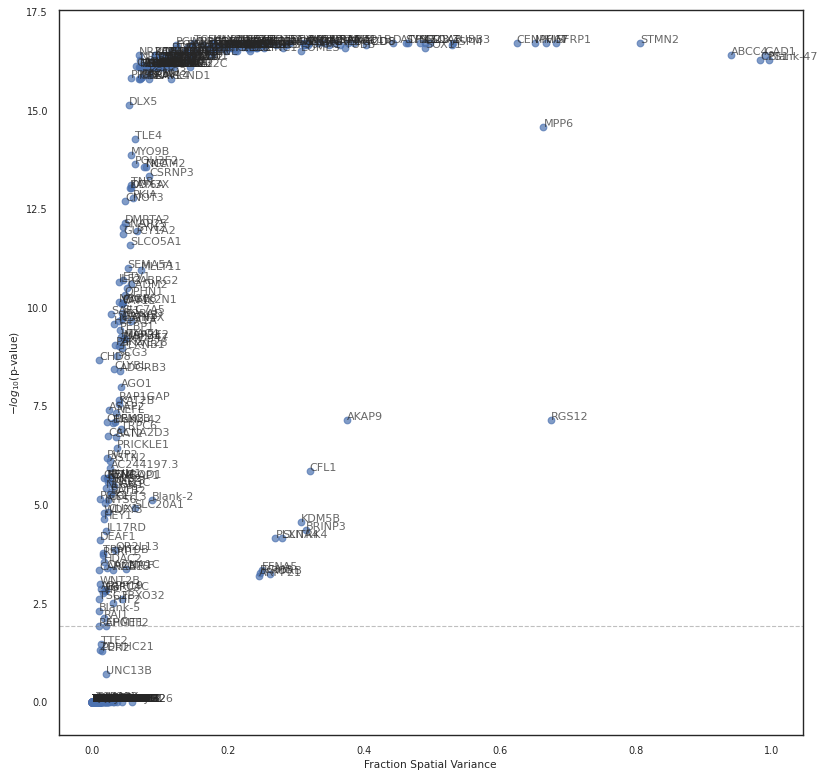

In [17]:
# from plot import FSV_sig

# adapted from spatialDE's plot.py (which has display problems with y log scale in ipython notebook)

fig, ax = plt.subplots(figsize=(12, 12), dpi=80)

# change p-values that are 0 to half lowest postive p-value
# ---------------------------------------------------------

pvals = results[pval_type]
print(f"p-values dataypte is: {pvals.dtype}\n")

# lowest_nonzero_pval = pvals[pvals > 0].min()
# print(f"Lowest non-zero p-value: {lowest_nonzero_pval}\n")
# pvals = pvals.clip(lower = lowest_nonzero_pval / 2)

# plot -log10(p) vs FSV
# ---------------------

ax.scatter(results["FSV"], -1 * np.log10(pvals), alpha = 0.7,)

# draw FDR threshold line
# -----------------------

FDR_threshold = results.query('qval < 0.05')[pval_type].max()
plt.axhline(-1 * np.log10(FDR_threshold), ls='--', c="gray", lw=1, alpha=0.5, label='FDR = 0.05')

ax.set_ylabel(r"$-log_{10}($p-value$)$")
ax.set_xlabel("Fraction Spatial Variance")

# annotate with gene names
# ------------------------

for i, gene_name in enumerate(results['g']):
     plt.annotate(gene_name, (results['FSV'].iloc[i], -1*np.log10(pvals.iloc[i])),
                  fontsize=10, alpha=0.7,
                  )
        
#print(plt.gca().get_ylim())
#plt.gca().set_ylim((10,None))

## Filter only genes with significant Q-values

A q-value of 0.05 corresponds to a false discovery rate of 5%. Filter the dataframe for only q-value significant genes.

Record any blanks that are considered significant (and their ranks in terms of p-value, higher rank -> higher p-value).

In [18]:
# print the p-value ranks of blanks (and indicate if significant)

blank_ranks = np.where(results["g"].str.startswith("Blank") == True)[0]
#blank_ranks_sig = np.where(qval_significant_results["g"].str.startswith("Blank") == True)[0]
gene_names_sorted = results["g"].values

print(f"Ranks of blank genes:")
for blank_rank in blank_ranks:
    gene_name = gene_names_sorted[blank_rank]
    blank_str = f"{blank_rank + 1} : {gene_name}"
    if results["qval"].iloc[blank_rank] < 0.05:
        blank_str += " (signficant)"
    print(blank_str)

qval_significant_results = results[(results["qval"] < 0.05)].copy()

print(f"\nNumber of significant genes: {len(qval_significant_results)}")
    
qval_significant_results

Ranks of blank genes:
52 : Blank-8 (signficant)
122 : Blank-47 (signficant)
220 : Blank-42 (signficant)
242 : Blank-2 (signficant)
274 : Blank-5 (signficant)
296 : Blank-36
314 : Blank-3
316 : Blank-6
318 : Blank-45
345 : Blank-13
347 : Blank-27
354 : Blank-32
363 : Blank-49
370 : Blank-44
393 : Blank-34
399 : Blank-41
402 : Blank-1
406 : Blank-28
408 : Blank-7
433 : Blank-52
438 : Blank-23
441 : Blank-38
448 : Blank-22
452 : Blank-4
453 : Blank-51
457 : Blank-15
461 : Blank-48
467 : Blank-50
469 : Blank-11
491 : Blank-30
497 : Blank-14
499 : Blank-53
501 : Blank-18
506 : Blank-19
517 : Blank-20
530 : Blank-37
534 : Blank-43
538 : Blank-9
542 : Blank-12
551 : Blank-25
552 : Blank-29
557 : Blank-35
565 : Blank-16
575 : Blank-24
576 : Blank-10
579 : Blank-17
580 : Blank-40
587 : Blank-26
591 : Blank-39
594 : Blank-21
597 : Blank-31
607 : Blank-33
608 : Blank-46

Number of significant genes: 277


,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval_min,pval_ccr,qval
4258,0.806540,4,STMN2,426.756263,0.237745,-1515.092346,2.831479,0.500754,SE,5262,9.177262e-07,0.000037,0.008476,3064.457758,-5405.467094,3890.374748,5.311305e-311,1.949086e-17,1.981571e-16
3890,0.682617,4,SFRP1,426.756263,0.460843,525.797646,1.803973,0.154626,SE,5262,1.268907e-06,0.000030,0.014851,-1017.322226,-2523.541399,3049.339044,5.311305e-311,1.949086e-17,1.981571e-16
4722,0.668409,4,VIM,426.756263,0.491707,-2017.607134,2.122034,0.301537,SE,5262,2.759937e-06,0.000063,0.006520,4069.487335,-4366.582613,2348.975478,5.311305e-311,1.949086e-17,1.981571e-16
2834,0.651806,4,MKI67,426.756263,0.529480,1183.984193,1.655731,0.117569,SE,5262,2.879629e-06,0.000063,0.005571,-2333.695320,-993.017668,2177.001861,5.311305e-311,1.949086e-17,1.981571e-16
1058,0.624856,4,CENPF,426.756263,0.595064,1544.216327,1.646336,0.104795,SE,5262,2.557967e-06,0.000053,0.006315,-3054.159588,-580.961936,2125.178263,5.311305e-311,1.949086e-17,1.981571e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3356,0.029814,4,PHF2,2159.131002,26.791489,2483.825441,1.629948,0.004303,SE,5262,1.043867e-04,0.096101,0.010986,-4933.377817,2470.888031,12.937411,3.220802e-04,3.123673e-03,6.979637e-03
724,0.009034,4,Blank-5,2159.131002,90.315037,13109.990775,1.544849,0.002695,SE,5262,9.924687e-06,0.091421,0.018725,-26185.708483,13098.884437,11.106338,8.603321e-04,4.800369e-03,1.068695e-02
3612,0.017304,4,RAI1,2159.131002,46.755180,3002.851013,1.618658,0.003621,SE,5262,3.703130e-05,0.096181,0.014223,-5971.428960,2991.141438,11.709575,6.217932e-04,7.514803e-03,1.666920e-02
1556,0.020431,4,EHMT1,2159.131002,39.473531,2820.111937,1.619911,0.003794,SE,5262,3.522645e-05,0.066475,0.016076,-5605.950808,2808.857072,11.254865,7.941460e-04,1.177423e-02,2.602275e-02


## Plot most significant (lowest p-value) and non-signficiant (highest p-value) genes

Here we plot:
- genes by length scale
- lowest p-values (most significant first)
- highest p-values (least significant first)
- *optional* check aganist other gene lists from other methods or same method different parameter

In [19]:
smallest_pvals = results[:len(qval_significant_results)]["g"].tolist()

print(f"{len(smallest_pvals)} most-signficiant/lowest p-values (starting from best):\n{smallest_pvals}")

277 most-signficiant/lowest p-values (starting from best):
['STMN2', 'SFRP1', 'VIM', 'MKI67', 'CENPF', 'GLI3', 'SYNE2', 'TPX2', 'SOX2', 'SLC1A3', 'DACH1', 'TOP2A', 'TUBB3', 'NFIB', 'MAP1B', 'QKI', 'PTPRZ1', 'PHLDA1', 'HMGA2', 'DCX', 'EFNB2', 'EZR', 'CDH2', 'NEGR1', 'POTEF', 'LHX2', 'RPL8', 'HNRNPDL', 'TCF4', 'FZD8', 'MAP2', 'FGFBP3', 'SOX5', 'NTRK3', 'TBR1', 'S1PR1', 'MPPED2', 'CCND2', 'NES', 'ASPM', 'CTNNB1', 'MEIS2', 'FGFR2', 'JPH1', 'GLI2', 'CNTNAP2', 'MIR9-3HG', 'NEUROD6', 'PCLO', 'CA12', 'KIF11', 'Blank-8', 'SYT1', 'FOXG1', 'DAB1', 'HSP90AA1', 'GRIA1', 'DLGAP5', 'ZEB2', 'TUBB', 'B3GAT2', 'FOXP1', 'SLA', 'BCL11A', 'PDGFRB', 'KIF2C', 'FUT9', 'MIR100HG', 'FLRT2', 'GRIA2', 'DPYSL2', 'GTSE1', 'SOX11', 'BAZ2B', 'CKAP2L', 'FSTL1', 'IGFBP5', 'TTK', 'CCNB1', 'GPM6A', 'LIFR', 'PTPRF', 'IQSEC1', 'CALB2', 'KIF14', 'NFIA', 'EOMES', 'CDK5R1', 'PREX1', 'SERINC1', 'KANSL1', 'NR2F2', 'ABCC4', 'GAD1', 'ROBO2', 'IFI44L', 'KCNH7', 'MSH6', 'TFAP2C', 'KIF18A', 'NINL', 'NHLH1', 'DLG4', 'PHACTR3', 'LIX1'

**optional** Compare different sets of results

In [20]:
# list of region2 genes
region1_list = smallest_pvals
region2_list = ['CALB2', 'GLI2', 'HES1', 'KCNQ3', 'LIFR', 'MEF2C', 'MKI67', 'NFIB', 'NTNG2', 
                'FZD8', 'PRKCG', 'ELAVL4', 'DLG4', 'SLC1A3', 'SOX11', 'SOX5', 'TBR1', 'TNC', 
                'BCL11B', 'PTPRZ1', 'FOXG1', 'DAB1', 'DCX', 'SNAP25', 'PDE1A', 'SOX2', 'NFIA', 
                'STMN2', 'TLE4', 'NES', 'MYT1L', 'ASPM', 'CCNB1', 'COL24A1', 'TUBB3', 'GLI3', 
                'CTNNB1', 'VIM', 'GAD2', 'SLA', 'SLC1A2', 'LGI2', 'GAD1', 'NHLH1', 'EOMES', 
                'DISC1', 'HMGA2', 'FAM107A', 'POU3F2', 'NKX2-1', 'RPS6', 'PECAM1', 'CUX1', 
                'SCN4B', 'HES6', 'OLIG2', 'EMX1', 'SV2C', 'RELN', 'ETV1', 'RORB', 'CDH24', 
                'NFATC2', 'CPNE7', 'NEFL', 'DLX5']

common_genes = [gene for gene in region1_list if gene in region2_list]
region1_unique_genes = [gene for gene in region1_list if gene not in region2_list]
region2_unique_genes = [gene for gene in region2_list if gene not in region1_list]

print(f"Length of region 1 list: {len(region1_list)}\n"
      f"{len(region1_unique_genes)} unique genes from region 1:\n{region1_unique_genes}\n\n"
      f"Length of region 2 list: {len(region2_list)}\n"
      f"{len(region2_unique_genes)} unique genes from region 2:\n{region2_unique_genes}\n\n"
      f"{len(common_genes)} common genes:\n {common_genes}"
     )

#common_genes

Length of region 1 list: 277
230 unique genes from region 1:
['SFRP1', 'CENPF', 'SYNE2', 'TPX2', 'DACH1', 'TOP2A', 'MAP1B', 'QKI', 'PHLDA1', 'EFNB2', 'EZR', 'CDH2', 'NEGR1', 'POTEF', 'LHX2', 'RPL8', 'HNRNPDL', 'TCF4', 'MAP2', 'FGFBP3', 'NTRK3', 'S1PR1', 'MPPED2', 'CCND2', 'MEIS2', 'FGFR2', 'JPH1', 'CNTNAP2', 'MIR9-3HG', 'NEUROD6', 'PCLO', 'CA12', 'KIF11', 'Blank-8', 'SYT1', 'HSP90AA1', 'GRIA1', 'DLGAP5', 'ZEB2', 'TUBB', 'B3GAT2', 'FOXP1', 'BCL11A', 'PDGFRB', 'KIF2C', 'FUT9', 'MIR100HG', 'FLRT2', 'GRIA2', 'DPYSL2', 'GTSE1', 'BAZ2B', 'CKAP2L', 'FSTL1', 'IGFBP5', 'TTK', 'GPM6A', 'PTPRF', 'IQSEC1', 'KIF14', 'CDK5R1', 'PREX1', 'SERINC1', 'KANSL1', 'NR2F2', 'ABCC4', 'ROBO2', 'IFI44L', 'KCNH7', 'MSH6', 'TFAP2C', 'KIF18A', 'NINL', 'PHACTR3', 'LIX1', 'EPHA7', 'PLCH1', 'FAM171B', 'SLC39A10', 'AUTS2', 'ITGB8', 'PLPPR4', 'NRN1', 'RTKN2', 'ERBIN', 'SCN3B', 'FRMD4B', 'TCF7L2', 'CPS1', 'Blank-47', 'SYT13', 'ADCYAP1R1', 'CPLX2', 'CAPRIN1', 'SUGP2', 'FAM49A', 'PTPN13', 'PGM2L1', 'VSTM2L', 'KIF5A', 'CCN

Plot significant genes **grouped by length scale of most significant p-value**.


--------------------------------------------------------------------------------
Length scale 0 : 84.34916987762207
--------------------------------------------------------------------------------

Number of genes: 10
Plots per row: 5
Number of rows: 3


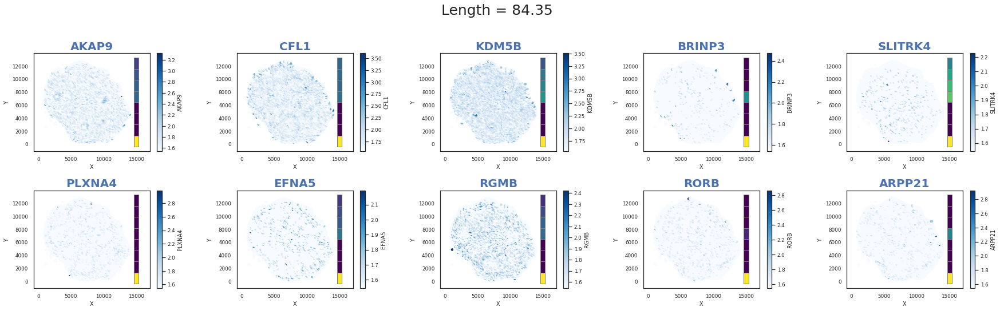


--------------------------------------------------------------------------------
Length scale 1 : 189.7275322411719
--------------------------------------------------------------------------------

Number of genes: 4
Plots per row: 5
Number of rows: 1


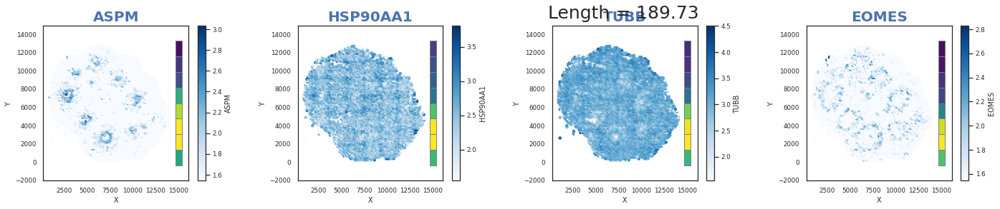


--------------------------------------------------------------------------------
Length scale 2 : 426.75626259926963
--------------------------------------------------------------------------------

Number of genes: 127
Plots per row: 5
Number of rows: 26


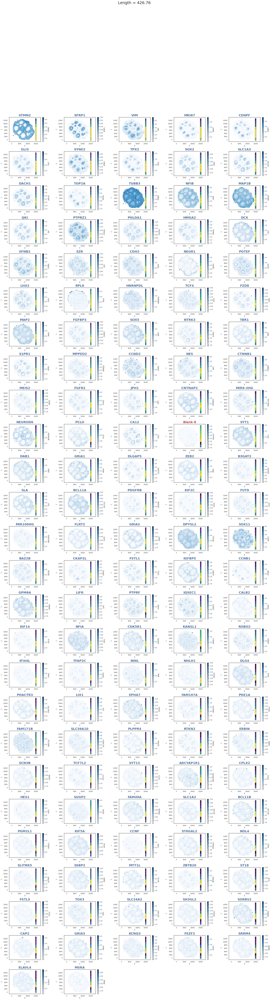


--------------------------------------------------------------------------------
Length scale 3 : 959.907639741997
--------------------------------------------------------------------------------

Number of genes: 109
Plots per row: 5
Number of rows: 22


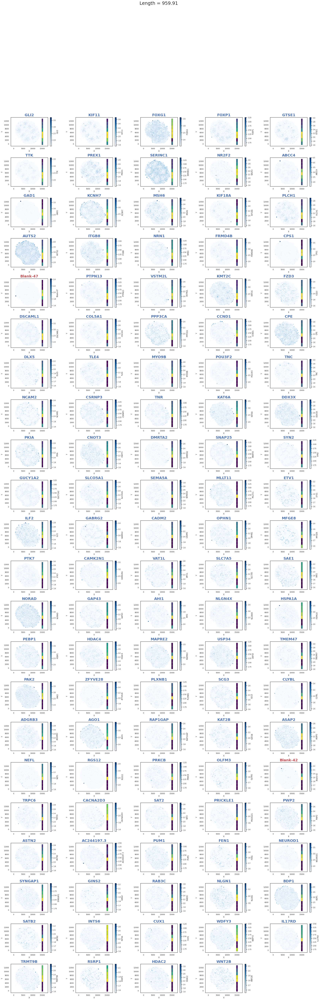


--------------------------------------------------------------------------------
Length scale 4 : 2159.1310019046655
--------------------------------------------------------------------------------

Number of genes: 21
Plots per row: 5
Number of rows: 5


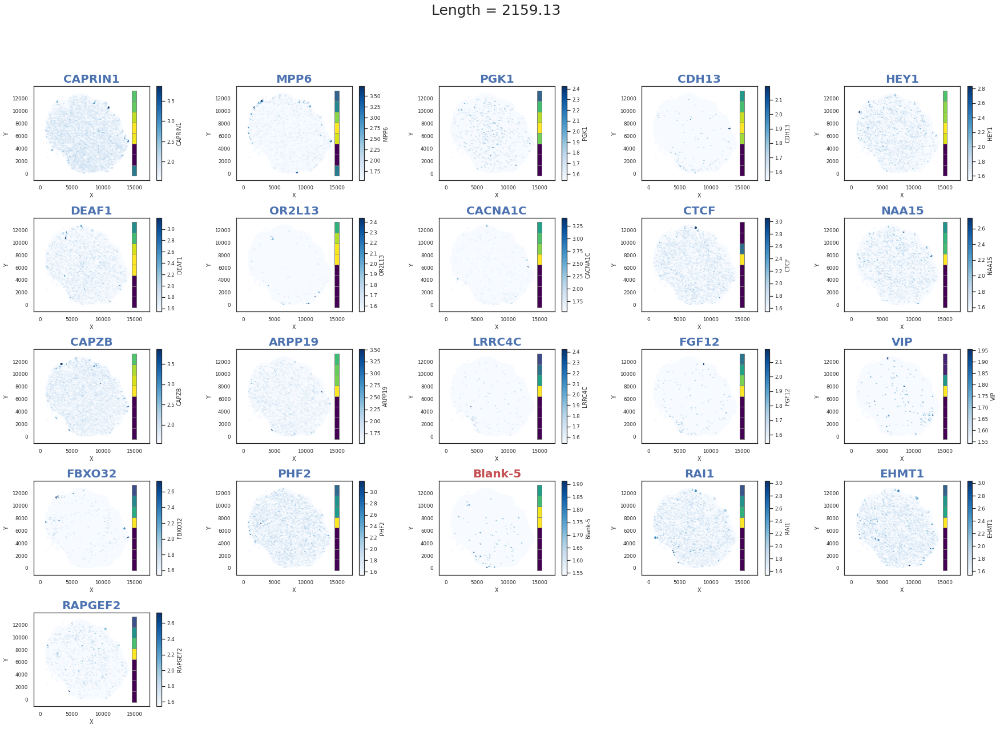


--------------------------------------------------------------------------------
Length scale 5 : 4856.557537805247
--------------------------------------------------------------------------------

Number of genes: 3
Plots per row: 5
Number of rows: 1


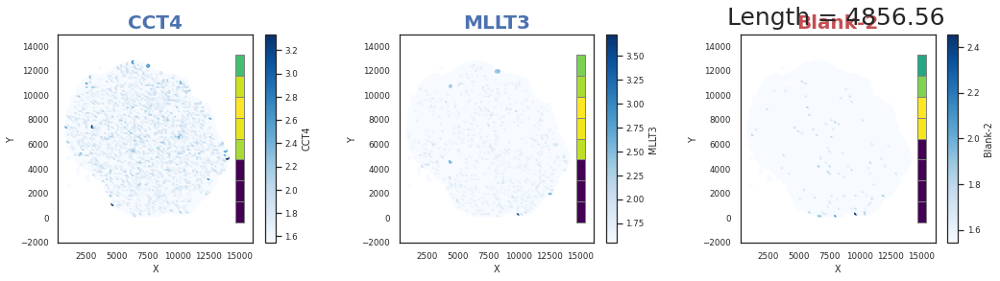


--------------------------------------------------------------------------------
Length scale 6 : 10923.909247380821
--------------------------------------------------------------------------------

Number of genes: 2
Plots per row: 5
Number of rows: 1


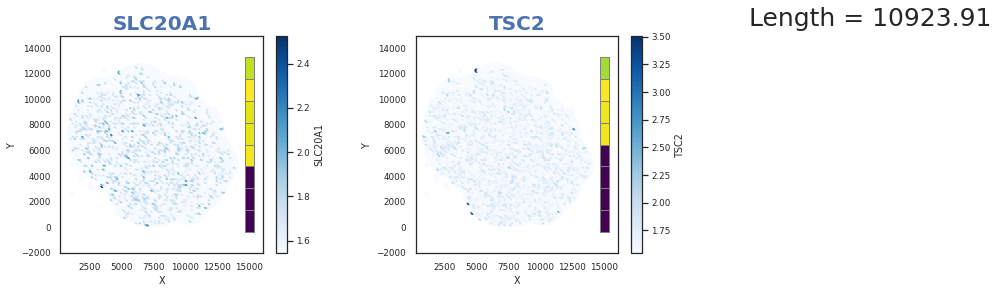


--------------------------------------------------------------------------------
Length scale 7 : 24571.27138226804
--------------------------------------------------------------------------------

Number of genes: 1
Plots per row: 5
Number of rows: 1


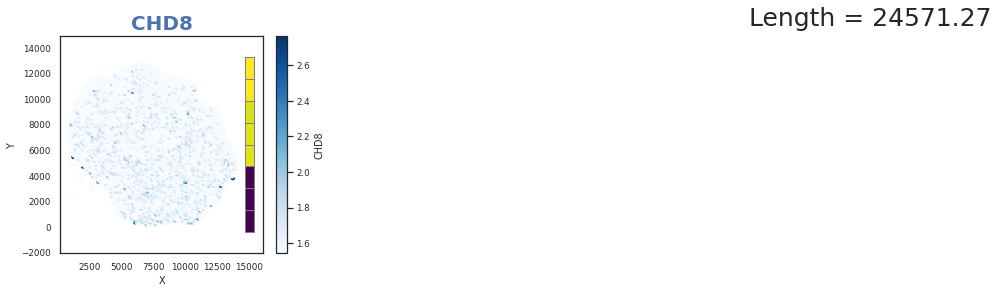

In [21]:
for i, l in enumerate(length_scales):
    
    l_list = results[results["l"] == l]["g"]
    l_list = [gene for gene in l_list if gene in smallest_pvals]

    if len(l_list) == 0:
        
        print("\n" + "-"*80 + f"\nLength scale {i} : {l}  ...  No genes found!\n" + "-"*80)

    else:
        
        print("\n" + "-"*80 + f'\nLength scale {i} : {l}\n' + "-" * 80 + "\n")

        plot_genes(l_list, df, results_df = model_results,
                   x_colname = "X", y_colname = "Y",
                   colormap = "Blues", 
                   vmin = None, vmax = None,
                   take_log = True,
                   main_title = f'Length = {l:0.2f}',
                   plots_per_row = 5,
                   verbose=False,
                  )

#### Plot the smallest (most significant) p-values

starting from most significant

['STMN2', 'SFRP1', 'VIM', 'MKI67', 'CENPF', 'GLI3', 'SYNE2', 'TPX2', 'SOX2', 'SLC1A3', 'DACH1', 'TOP2A', 'TUBB3', 'NFIB', 'MAP1B', 'QKI']
Number of genes: 16
Plots per row: 4
Number of rows: 5


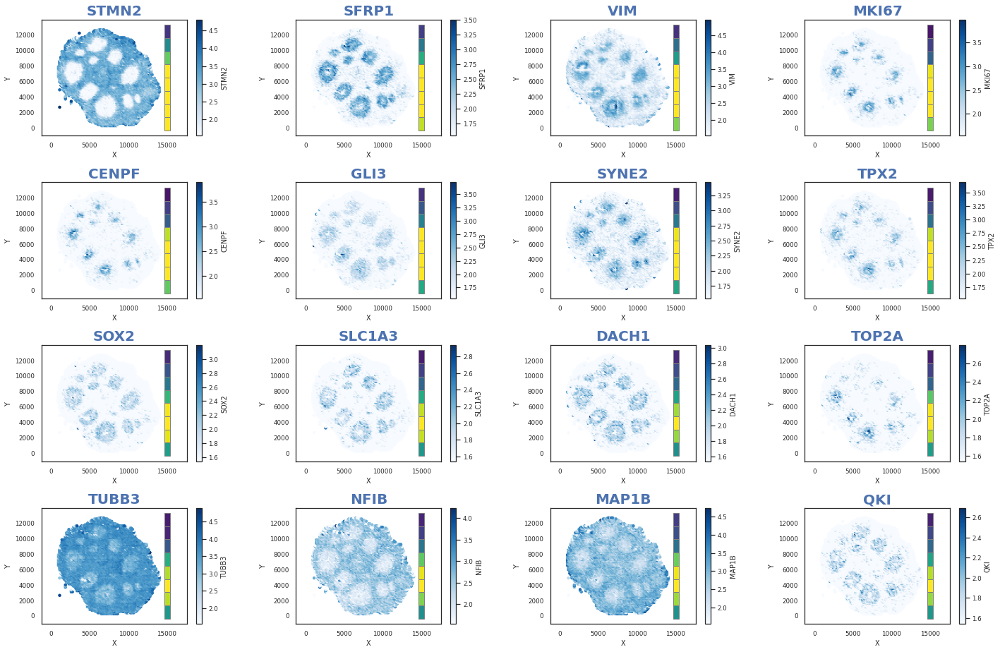

In [22]:
# plot_list = smallest_pvals
plot_list = smallest_pvals[:16]
print(plot_list)

plot_genes(plot_list, df, results_df = model_results,
           x_colname = "X", y_colname = "Y",
           colormap = "Blues", 
           vmin = None, vmax = None,
           take_log = True,
           verbose=False,
          )

#### Plot the largest (least significant) p-values

starting from least significant

In [23]:
highest_pvals = results[:-(len(gene_list)+1-len(qval_significant_results)):-1]["g"]

print(f"{len(highest_pvals)} least-signficiant/highest p-values (starting from worst):\n{highest_pvals}")

plot_list = highest_pvals
#plot_list = highest_pvals[:16]

'''
plot_genes(plot_list, df, results_df = model_results,
           x_colname = "X", y_colname = "Y",
           colormap = "Blues", 
           vmin = None, vmax = None,
           take_log = True,
           plots_per_row = 5,
           verbose = False,
          )
'''

333 least-signficiant/highest p-values (starting from worst):
1016       CDH24
3057      NKX2-1
688     Blank-46
576     Blank-33
2904         MX2
          ...   
4413      TCEAL2
4668      UNC13B
3308        PER2
4828     ZDHHC21
4628        TTF2
Name: g, Length: 333, dtype: object


'\nplot_genes(plot_list, df, results_df = model_results,\n           x_colname = "X", y_colname = "Y",\n           colormap = "Blues", \n           vmin = None, vmax = None,\n           take_log = True,\n           plots_per_row = 5,\n           verbose = False,\n          )\n'

In [24]:
#@title Dendrogram clustering
#CUSTOM1: Run after SpatialDE, find "ivl"
print(len(smallest_pvals))

df_smallest_pvals = df[df.columns & smallest_pvals]
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
###display(df_smallest_pvals)

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree

###display(df_selected)
# print(dendrogram_smallest_pvals["ivl"])

def get_gene_in_clusters(linked, n=30):
      #function to get different clusters based on distance number of cluster
    
      get_max = len(linked)+1
      dictt = {}
      for i in range(get_max):
          dictt[i] = [i,[i,]]
      counter = get_max
      for i in linked:
            dictt[int(counter)] = [i[0:2],dictt[int(i[0])][1]+dictt[int(i[1])][1]]
            counter += 1
      thres = 2*(get_max-1)-n+1
      clusters = []
      for i in range(1,n):
            linked[-i][:2] <= thres
            clusters += [linked[-i][:2][linked[-i][:2] <= thres],]
      return [dictt[i][1] for i in np.concatenate(clusters)]





def llf1(xx):
    aggr_label=''
    for lbl in label_dic[xx]:
      aggr_label+=str(lbl)+' '
    return aggr_label


def llf2(xx):
    print(grouplabels)
    return grouplabels[xx]

    


def run_Dendro(P,N, linked, no_plot, t_mode, linkage_method):

  #plt.figure(figsize=(20, 20), dpi=300)

  #====full dendrogram=====
  '''
  plt.title('Hierarchical Clustering Dendrogram (untruncated)', fontsize=10)
  dendrogram_no_truncated = dendrogram(linked , labels= df_selected.index, leaf_rotation=0, orientation="left", color_threshold=50)
  plt.show()
  #

  '''

  #====helper dendrogram(no plot)=====



  dendrogram_truncated = dendrogram(linked , 
                                    leaf_rotation=0, 
                                    orientation="left", 
                                    color_threshold=50, 
                                    truncate_mode=t_mode, 
                                    p=P, 
                                    no_plot=no_plot)

  #helper functions to extract groups from linkage matrix
  def get_labels(idx, head):
      row=linked[idx-N]
      lidx=int(row[0])
      ridx=int(row[1])
      if lidx>=N:
        get_labels(lidx,head)
      if ridx>=N:                 
        get_labels(ridx,head)
      if lidx<N: 
        label_dic[head]+=[df_selected.index.values[lidx]]
      if ridx<N:
        label_dic[head]+=[df_selected.index.values[ridx]]

  #dic to store labels
  label_dic={}
  for idx in dendrogram_truncated["leaves"]:
    label_dic[idx]=[]
    #print(idx)
    if idx>=N:
      get_labels(idx, idx)
    else:
      label_dic[idx]=[df_selected.index.values[idx]]

  #print(label_dic)

  #cluster_labels
  inverse_dic={}
  clusterlabels=[]
  for i,key in enumerate(label_dic):
    for gene in label_dic[key]:
      inverse_dic[gene]=i

  for gene in df_selected.index:
    clusterlabels.append(inverse_dic[gene])




  '''
  #====truncated dendrogram 1 (without legend)=====
  plt.title('Hierarchical Clustering Dendrogram (truncated)', fontsize=10)
  dendrogram_truncated = dendrogram(linked , 
                                    leaf_rotation=0, 
                                    orientation="left", 
                                    color_threshold=50, 
                                    truncate_mode='lastp',
                                    leaf_label_func=llf1,
                                    p=P, 
                                    )
  plt.show()        
  '''
  #print(len(dendrogram_truncated['leaves']))
  #group names
  groups=['Group '+str(i) for i in range(1,len(label_dic)+1)]
  grouplabels= {dendrogram_truncated["leaves"][ii]: groups[ii] for ii in range(len(dendrogram_truncated["leaves"]))}
 

  legendlabels=""
  for idx in dendrogram_truncated["leaves"]:
    list_of_labels=grouplabels[idx]+": "
    for i,lbl in enumerate(label_dic[idx]):
      if (i>0 and i%10==0):
        lbl=str(lbl)+"\n"+" "*13
      list_of_labels+=lbl+" "
    legendlabels+=list_of_labels+"\n"

    #====truncated dendrogram 2=====
  #plt.title('Hierarchical Clustering Dendrogram (truncated horizontal)', fontsize=10)

  dendrogram_truncated = dendrogram(linked , 
                                    leaf_rotation=0, 
                                    orientation="left", 
                                    #color_threshold=50, 
                                    truncate_mode=t_mode,
                                    #leaf_label_func=llf2,
                                    p=P, 
                                    no_plot=no_plot
                                    )

  #print((dendrogram_no_truncated['ivl']))
  #plt.text(0.1, -2.2,legendlabels, transform=plt.gcf().transFigure)
  #P=len(label_dic)
  #plt.show()
  #print(legendlabels)
  return label_dic, clusterlabels

'''
#====truncated dendrogram 2 (vertical)=====

plt.title('Hierarchical Clustering Dendrogram (truncated vertical)', fontsize=10)
dendrogram_truncated = dendrogram(linked , 
                                  leaf_rotation=0, 
                                  orientation="top", 
                                  color_threshold=50, 
                                  truncate_mode='lastp',
                                  leaf_label_func=llf2,
                                  p=P, 
                                  )
leaves=dendrogram_truncated['leaves']
plt.xticks(rotation=90)
plt.text(0.1, -2.4,legendlabels, transform=plt.gcf().transFigure)

plt.show()
#print(legendlabels)
'''
'''
dendrogram_smallest_pvals = dendrogram(linked, leaf_label_func=llf2, no_plot=True, leaf_rotation=0, orientation="top", color_threshold=50, truncate_mode='lastp', p=P)
ivl_leaves_list = dendrogram_smallest_pvals["ivl"]

# ivl_leaves_list.reverse()
print('ivl: ',ivl_leaves_list)

gene = []
for value in temp.values():
    gene.extend(value)

print('gene:', gene)
'''


df_selected = df_smallest_pvals[df_smallest_pvals.columns[:]].T

#scaling
scl = StandardScaler()
dfnorm = scl.fit_transform(df_selected)
dfnorm = pd.DataFrame(df_selected)

#PCA on data
reduced_data = PCA(n_components=2).fit_transform(dfnorm)
#label = get_gene_in_clusters(linkage(df_selected, method='ward', metric='euclidean'),n=30)
#temp = {dendrogram_smallest_pvals["leaves"][i]: list(df_selected.index[(label[i])]) for i in range(len(dendrogram_smallest_pvals["leaves"]))}
#print(temp)

#dim
N=len(df_selected)
#======params for truncate mode=====
P=30
t_mode='lastp'
linkage_method='ward'
linked = linkage(reduced_data, method=linkage_method, metric='euclidean')

gene_dic_hier, clusterlabels=run_Dendro(P,N, linked, no_plot=True,t_mode=t_mode, linkage_method=linkage_method)
print(clusterlabels)
'''
#get average genes data
average_genes={}
genes=gene_dic_hier
for i, grpidx in enumerate(genes.keys()):
        #print(grpidx)
        #group average for reference plot
        
        group_average=sum([df[gene] for gene in genes[grpidx] if gene in df.columns])/len(genes[grpidx])
        average_genes['group'+str(i+1)+'_average']=group_average
        df['group'+str(i+1)+'_average']=group_average
'''

277
[4, 6, 8, 4, 9, 4, 9, 9, 6, 9, 10, 6, 29, 4, 17, 25, 8, 24, 5, 5, 5, 5, 5, 6, 11, 5, 5, 5, 7, 6, 8, 24, 23, 4, 4, 21, 4, 9, 5, 21, 22, 16, 24, 6, 4, 5, 9, 25, 4, 23, 8, 5, 8, 9, 21, 4, 26, 16, 28, 9, 9, 26, 11, 5, 5, 27, 7, 6, 17, 9, 8, 11, 22, 11, 4, 17, 4, 21, 8, 5, 5, 8, 5, 10, 11, 8, 24, 11, 4, 4, 6, 11, 4, 10, 6, 5, 6, 5, 11, 16, 26, 22, 22, 7, 4, 6, 6, 4, 4, 4, 10, 21, 14, 4, 4, 8, 6, 9, 4, 11, 9, 4, 24, 4, 9, 22, 9, 24, 4, 4, 5, 4, 22, 23, 11, 11, 4, 5, 2, 29, 8, 11, 5, 11, 17, 16, 8, 6, 6, 11, 11, 6, 4, 7, 4, 6, 5, 7, 17, 6, 25, 26, 13, 6, 9, 4, 4, 7, 24, 6, 6, 11, 5, 4, 5, 23, 7, 8, 4, 8, 6, 7, 7, 9, 17, 7, 4, 6, 6, 4, 21, 4, 7, 11, 5, 4, 4, 4, 11, 20, 9, 6, 10, 6, 9, 5, 6, 9, 5, 4, 6, 8, 5, 4, 11, 4, 6, 5, 6, 7, 4, 26, 18, 8, 22, 7, 10, 4, 7, 11, 6, 4, 5, 4, 7, 8, 15, 16, 25, 7, 8, 8, 7, 1, 9, 6, 19, 6, 25, 7, 22, 23, 4, 4, 4, 4, 5, 6, 11, 11, 16, 6, 4, 9, 4, 3, 0, 9, 6, 12, 5, 5, 9, 6, 4, 22, 5]


"\n#get average genes data\naverage_genes={}\ngenes=gene_dic_hier\nfor i, grpidx in enumerate(genes.keys()):\n        #print(grpidx)\n        #group average for reference plot\n        \n        group_average=sum([df[gene] for gene in genes[grpidx] if gene in df.columns])/len(genes[grpidx])\n        average_genes['group'+str(i+1)+'_average']=group_average\n        df['group'+str(i+1)+'_average']=group_average\n"

In [25]:
#@title Kmean clustering
#=======================using Kmean Clustering=================================
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
#elbow to find optimal K
def find_optimal_k(data=reduced_data):
    kmeans_kwargs = {"init": "random",
                      "n_init": 10,
                      "max_iter": 300,
                      "random_state": 0,
                      }

    # A list holds the SSE values for each k
    sse = []
    for k in range(1, 21):
      kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
      kmeans.fit(data)
      sse.append(kmeans.inertia_)

    plt.style.use("fivethirtyeight")
    plt.plot(range(1, 21), sse)
    plt.xticks(range(1, 21))
    plt.xlabel("Number of Clusters")
    plt.ylabel("SSE")
    plt.show()

def Refine_clusters(labels, cut_off=30, rounds=1):
  while rounds:
    for cluster_num, cluster in enumerate(labels):
      num_partition=len(cluster)//cut_off
      if num_partition:
        inner_cluster_data=[reduced_data[i] for i in cluster]
        inner_kmeans=KMeans(n_clusters=num_partition+1, random_state=0, init='random').fit(inner_cluster_data)
        labels=labels[:cluster_num]+labels[cluster_num+1: ]+[ClusterIndicesComp(i,inner_kmeans.labels_) for i in range(num_partition+1)]
    rounds-=1

  return labels

#====look up values in cluster====

def ClusterIndicesComp(clustNum, labels_array): 
    return np.array([i for i, x in enumerate(labels_array) if x == clustNum])

def run_Kmeans(K, data, plot_dist=True):


  #====find optimal k using elbow====
  #find_optimal_k(reduced_data)

  kmeans=KMeans(n_clusters=K, random_state=0, init='random').fit(data)
  #y_kmeans=kmeans.predict(reduced_data)
  clusterlabels=kmeans.labels_
  clustercenters=kmeans.cluster_centers_
  #print(kmeans.fit_predict(reduced_data))

  #refine clusters
 
  #print('inertia: ',kmeans.inertia_)

  #====clustering on clusters to generate subclusters====
  #labels=Refine_clusters(labels, 30, rounds=1)
  #K=len(labels)      


  #print clusters
  '''
  print("clusters:")
  for idx, clusters in enumerate(labels):
    print(idx, clusters)
  '''
  #====plot distributions of genes(clustered and unclustered) in 2D====
  if plot_dist:
    fig=plt.figure(figsize=(20,20))
    ax1=fig.add_subplot(211)
    ax1.set_title('distribution of genes in 2 dimension', fontsize=20)
    ax1.scatter(data[:, 0], data[:, 1])
    #plt.show()

    ax2=fig.add_subplot(212)
    ax2.scatter(data[:, 0], data[:, 1], c=y_kmeans, s=10, cmap='viridis')
    centers = kmeans.cluster_centers_
    ax2.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);
    ax2.set_title('distribution of '+str(K)+' clustered genes in 2 dimension',fontsize=20)




  return clustercenters, clusterlabels

#-----------------------------------------------------------------
#scaling
scl = StandardScaler()
dfnorm = scl.fit_transform(df_selected)
dfnorm = pd.DataFrame(df_selected)

#PCA on data
reduced_data = PCA(n_components=2).fit_transform(dfnorm)
#reduced_data=df_selected
K=25

_ , clusterlabels=run_Kmeans(K, reduced_data, False)
labels=[ClusterIndicesComp(i, clusterlabels) for i in range(K)]
#====dic to store cluster info====
gene_dic_kmean={}
for i in range(K):
  gene_dic_kmean[i]=[df_selected.index.values[gene_idx] for gene_idx in labels[i]]
  

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.datasets.samples_generator module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.datasets. Anything that cannot be imported from sklearn.datasets is now part of the private API.
  warnings.warn(message, FutureWarning)


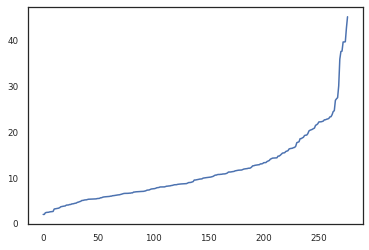

In [26]:
#@title DBSCAN clustering
import numpy as np
from sklearn.datasets.samples_generator import make_blobs
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from matplotlib import pyplot as plt

#find eps

##get distance form neighbors
neigh = NearestNeighbors(n_neighbors=4)
nbrs = neigh.fit(df_selected)
distances, indices = nbrs.kneighbors(df_selected)

##sort distance and plot dist vs 
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)



In [27]:
#@title Self-Organizing Maps
#Self Organizing Maps
#!pip install biopython==1.76
import Bio
from Bio.Cluster import somcluster
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
#scaling
scl = StandardScaler()
dfnorm = scl.fit_transform(df_selected)
dfnorm = pd.DataFrame(df_selected)

#PCA on data
reduced_data = PCA(n_components=2).fit_transform(dfnorm)

#SOM params
nx=4
ny=4
Psom=nx*ny
init=0.02
data=reduced_data
clusterid, celldata = somcluster(data=data, nxgrid=nx, nygrid=ny, inittau=init, niter=5)
#print(clusterid)
#====build clusterlabels====
clusterlabels=[]

for coords in clusterid:
  clusterlabels.append(nx*coords[1]+coords[0])
#print(clusterlabels)
#====dic to store cluster info====
gene_dic_som={}
templabels=[ClusterIndicesComp(i, clusterlabels) for i in range(Psom)]
for i in range(Psom):
  gene_dic_som[i]=[df_selected.index.values[gene_idx] for gene_idx in templabels[i]]
print((gene_dic_som))
#print((celldata))

{0: ['AGO1', 'BAZ2B', 'CENPF', 'DACH1', 'DDX3X', 'GLI3', 'KAT6A', 'MIR9-3HG', 'MKI67', 'SOX2', 'TPX2'], 1: ['B3GAT2', 'CA12', 'CNOT3', 'DLGAP5', 'EHMT1', 'EOMES', 'FGFR2', 'FOXP1', 'FUT9', 'LIFR', 'MSH6', 'NINL', 'NTRK3', 'PREX1', 'PTPRF', 'S1PR1', 'SLC39A10', 'TOX3', 'USP34'], 2: ['ASPM', 'FGFBP3', 'FZD8', 'HMGA2', 'IQSEC1', 'ITGB8', 'PHF2', 'QKI'], 3: ['ERBIN', 'LHX2', 'MEIS2', 'MPPED2', 'SUGP2'], 4: ['EZR', 'NES', 'TCF4', 'VIM'], 5: ['CAP2', 'CPLX2', 'CSRNP3', 'DSCAML1', 'GRIA3', 'MLLT11', 'MYT1L', 'NEGR1', 'PHACTR3', 'SCN3B', 'SLC1A2', 'SRRM4', 'ST6GAL2'], 6: ['ADCYAP1R1', 'BCL11B', 'FLRT2', 'MAPRE2', 'PDE1A', 'PEBP1', 'RPL8', 'SH3GL2', 'SORBS2', 'ST18'], 7: ['EFNB2', 'KMT2C', 'PHLDA1', 'SFRP1', 'SYNE2'], 8: ['AKAP9', 'ELAVL4', 'FAM49A', 'FEZF2', 'GRIA1', 'GRIA2', 'IGFBP5', 'KCNH7', 'KIF5A', 'SLA', 'SSBP2', 'TBR1', 'ZEB2'], 9: ['GLI2', 'ILF2', 'MIR100HG', 'TOP2A'], 10: ['CAPRIN1', 'CAPZB', 'CCND2', 'CDH2', 'CTNNB1', 'FAM171B', 'FOXG1', 'HNRNPDL', 'HSP90AA1', 'KANSL1', 'KDM5B', 'MAP

In [28]:
#@title Agglomerative Clustering

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import sys
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree
from sklearn.neighbors import kneighbors_graph


#num of clusters
P=22
'''


#helper function to plot dendrogram
def plot_dendrogram(model, linkage=None, **kwargs):
    # Create linkage matrix and then plot the dendrogram
    if not linkage:
      # create the counts of samples under each node
        counts = np.zeros(model.children_.shape[0])
        n_samples = len(model.labels_)
        for i, merge in enumerate(model.children_):
            current_count = 0
            for child_idx in merge:
                if child_idx < n_samples:
                    current_count += 1  # leaf node
                else:
                    current_count += counts[child_idx - n_samples]
            counts[i] = current_count

        linkage_matrix = np.column_stack([model.children_, model.distances_,
                                          counts]).astype(float)

        # Plot the corresponding dendrogram
        return dendrogram(linkage_matrix, **kwargs)

    else:
      return dendrogram(linkage , **kwargs)
                                  

#build connectivity matrix
neigh = kneighbors_graph(df_selected, 5, mode='connectivity', include_self=True)
print(neigh.toarray())
agglo = AgglomerativeClustering(P,'euclidean', connectivity=neign).fit(df_selected)

labels=[ClusterIndicesComp(i, agglo.labels_) for i in range(P)]
for c_num, cluster in enumerate(labels):
  print(c_num, cluster)

gene_dic_hier={}
for i in range(P):
  gene_dic_hier[i]=[df_selected.index.values[gene_idx] for gene_idx in labels[i]]

print(len(gene_dic_hier))
dendro=plot_dendrogram(agglo, None, 
                                  leaf_rotation=90, 
                                  orientation="top", 
                                  color_threshold=50, 
                                  truncate_mode=t_mode,
                                  leaf_label_func=llf2,
                                  p=P,

                                  )
'''

'\n\n\n#helper function to plot dendrogram\ndef plot_dendrogram(model, linkage=None, **kwargs):\n    # Create linkage matrix and then plot the dendrogram\n    if not linkage:\n      # create the counts of samples under each node\n        counts = np.zeros(model.children_.shape[0])\n        n_samples = len(model.labels_)\n        for i, merge in enumerate(model.children_):\n            current_count = 0\n            for child_idx in merge:\n                if child_idx < n_samples:\n                    current_count += 1  # leaf node\n                else:\n                    current_count += counts[child_idx - n_samples]\n            counts[i] = current_count\n\n        linkage_matrix = np.column_stack([model.children_, model.distances_,\n                                          counts]).astype(float)\n\n        # Plot the corresponding dendrogram\n        return dendrogram(linkage_matrix, **kwargs)\n\n    else:\n      return dendrogram(linkage , **kwargs)\n                          

Plot Silouette Score for the clusters generated

For n_clusters = 7 The average silhouette_score is : 0.4661726439555429
For n_clusters = 8 The average silhouette_score is : 0.4343326809316208
For n_clusters = 9 The average silhouette_score is : 0.45312322116466636
For n_clusters = 10 The average silhouette_score is : 0.4555220041933339
For n_clusters = 11 The average silhouette_score is : 0.3921351456758611
For n_clusters = 12 The average silhouette_score is : 0.3863154020907492
For n_clusters = 13 The average silhouette_score is : 0.39384084808841496
For n_clusters = 14 The average silhouette_score is : 0.39919569416071926
For n_clusters = 15 The average silhouette_score is : 0.3662331207591633
For n_clusters = 16 The average silhouette_score is : 0.39108387233264996
For n_clusters = 17 The average silhouette_score is : 0.3759511903676658
For n_clusters = 18 The average silhouette_score is : 0.39714549879708344
For n_clusters = 19 The average silhouette_score is : 0.40422128933222434
For n_clusters = 20 The average silhouette_score

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


For n_clusters = 27 The average silhouette_score is : 0.3532912781489665


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


For n_clusters = 28 The average silhouette_score is : 0.34950565271924017


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


For n_clusters = 29 The average silhouette_score is : 0.3576194799855123


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


For n_clusters = 30 The average silhouette_score is : 0.34857298982704815


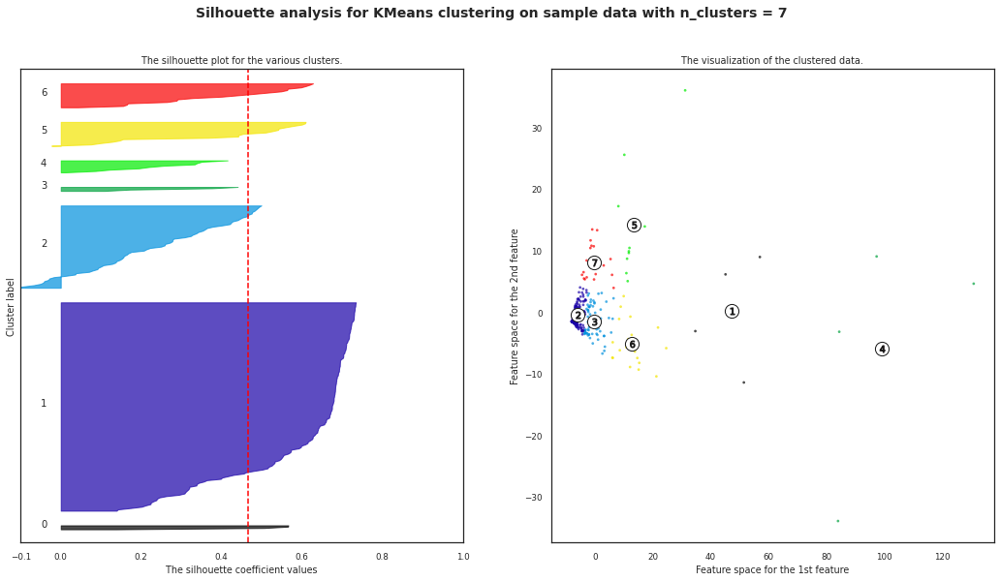

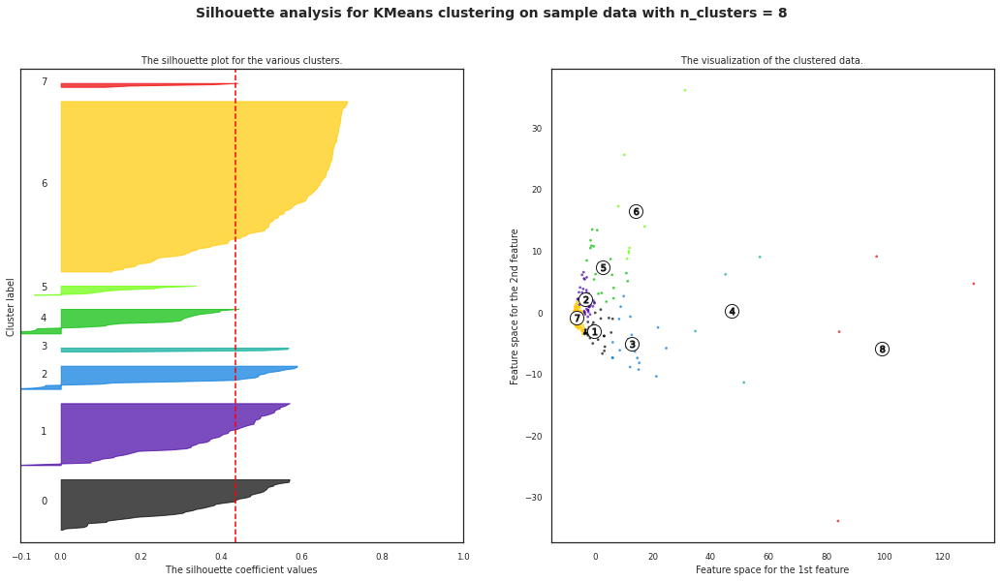

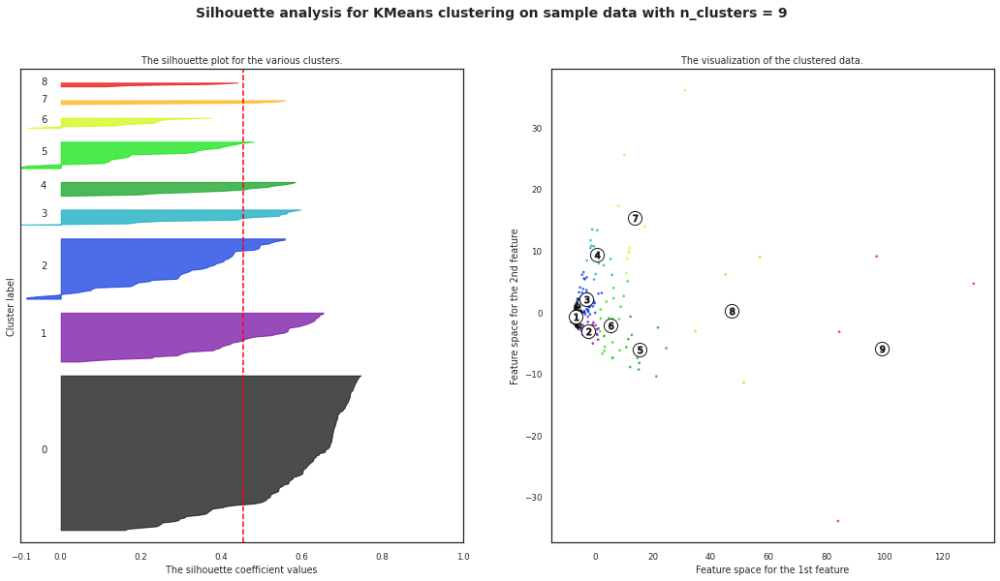

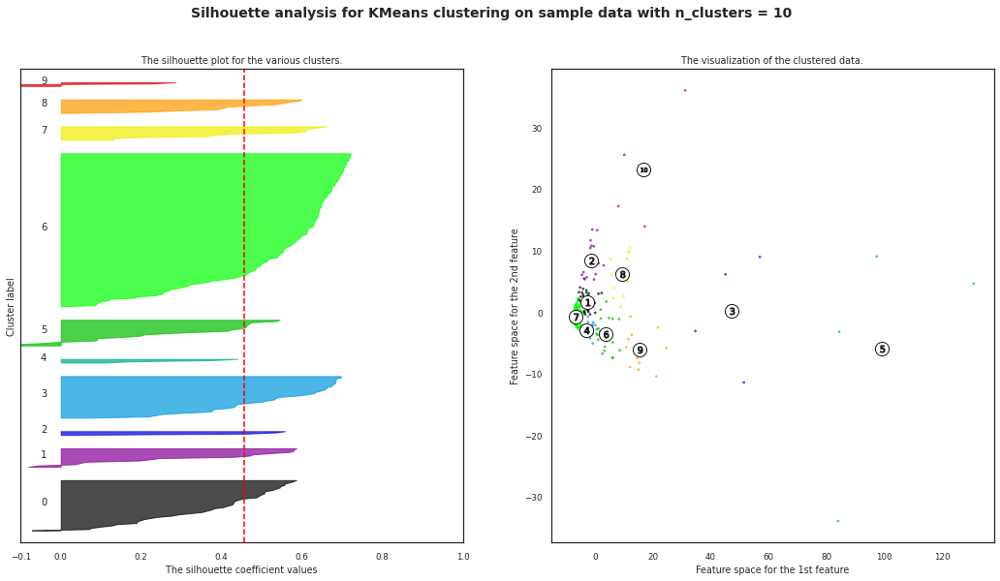

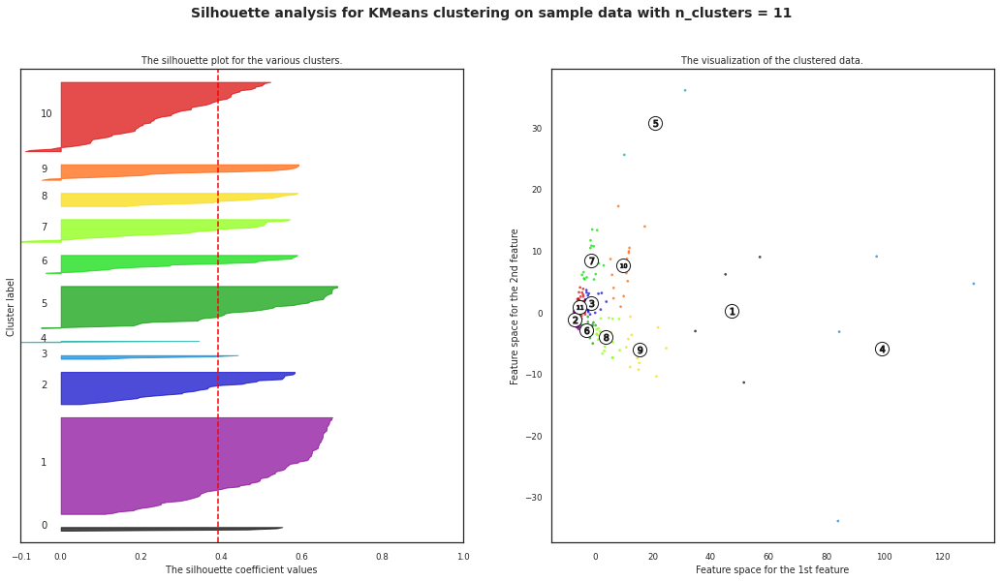

...

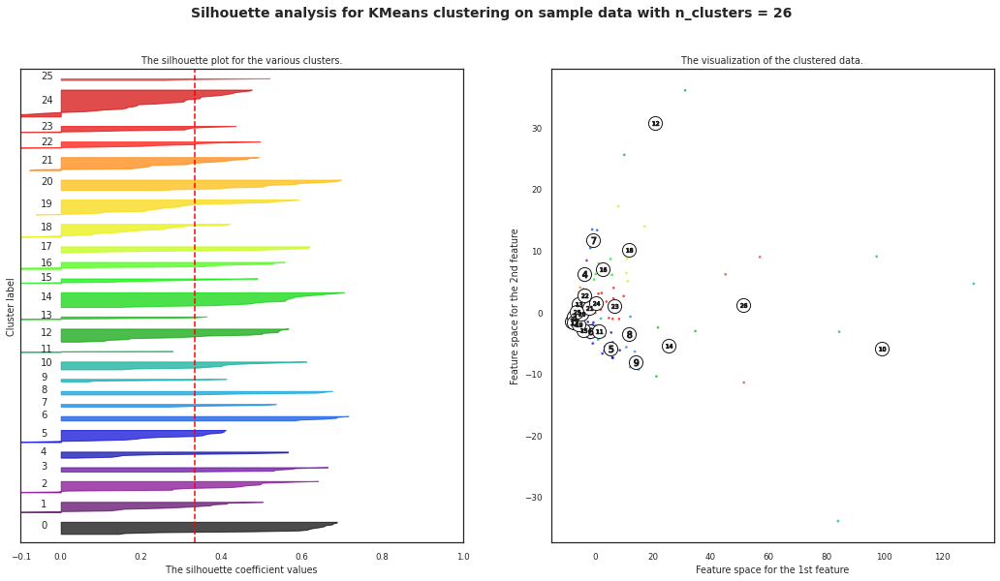

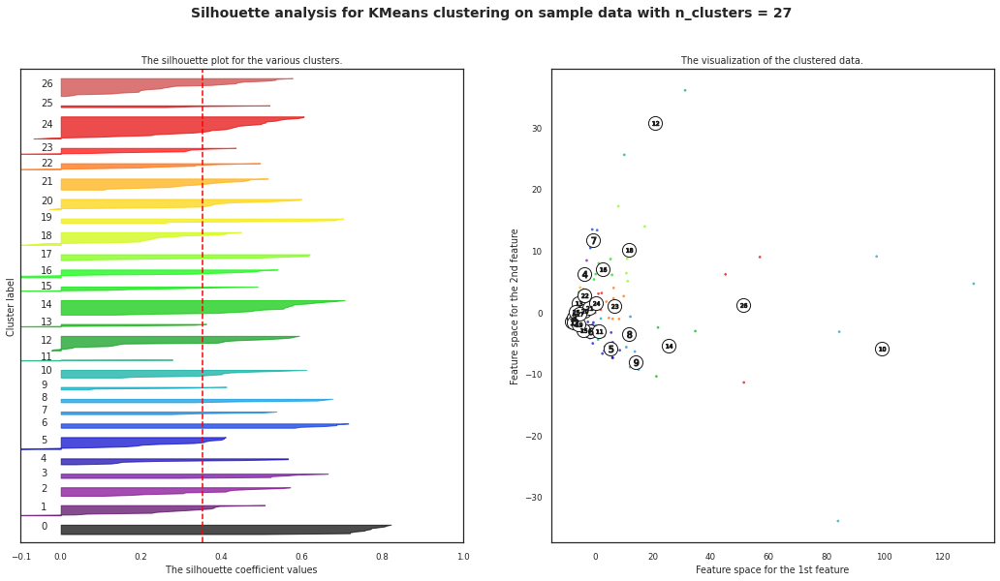

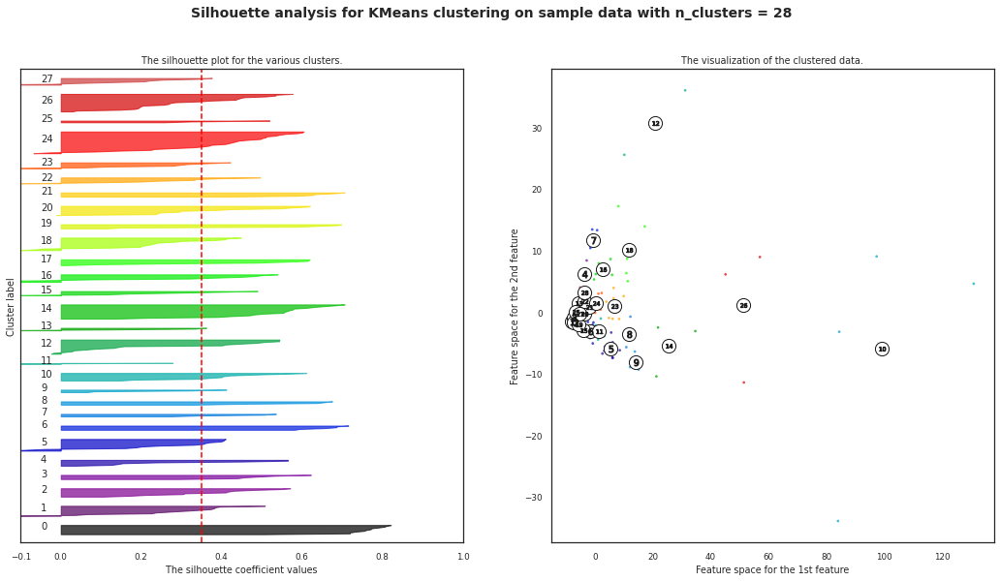

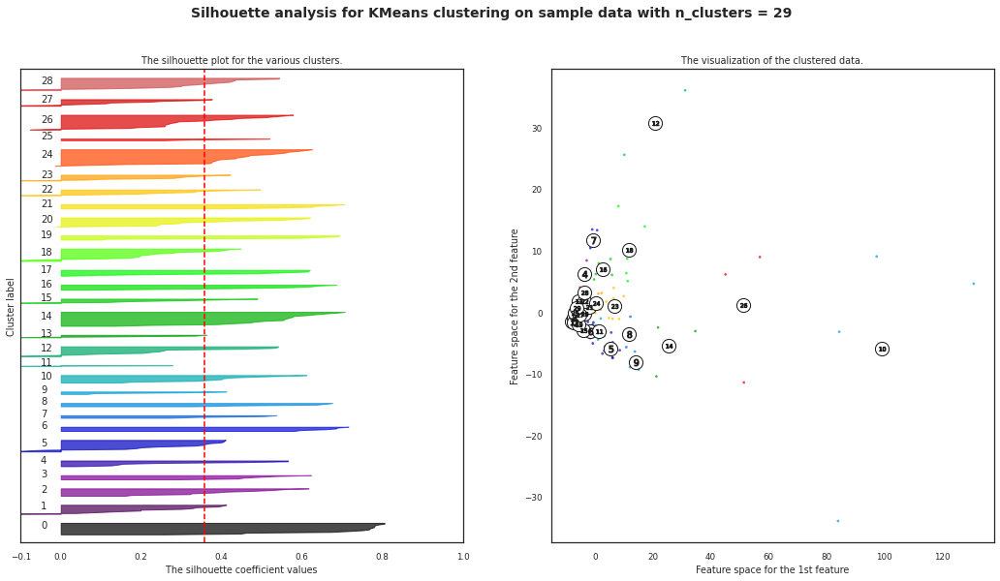

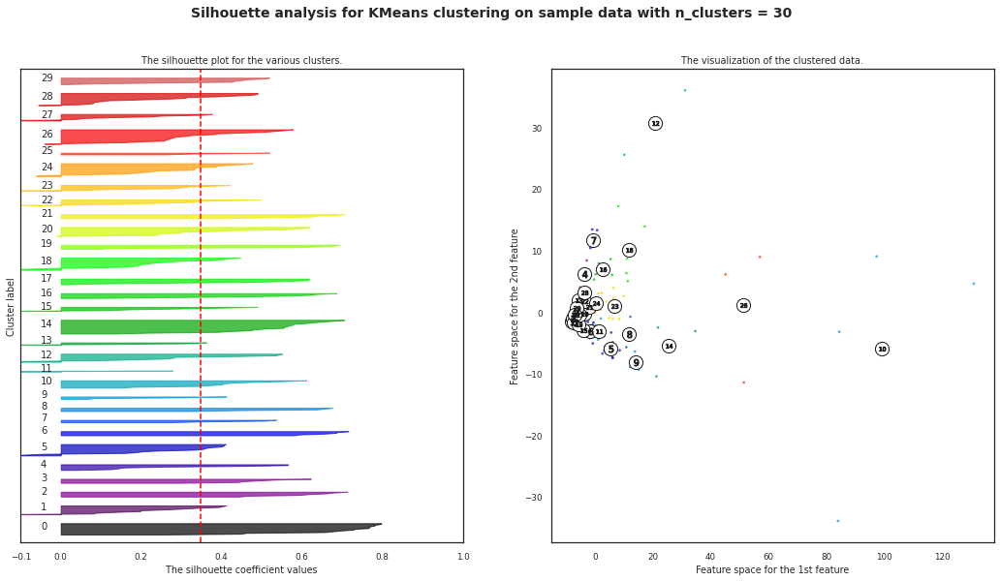

In [29]:
#@title Plot Silouette Score
#plot silouette score

from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np


range_n_clusters = [7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30]
X=reduced_data

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1,2)
    fig.set_size_inches(18, 9)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    #====cluster labels====
    centers, cluster_labels =run_Kmeans(n_clusters, X, False)
    '''
    _,cluster_labels=run_Dendro(n_clusters, N, linked, True, t_mode, linkage_method)
    cluster_labels=np.array(cluster_labels)
    '''
    #print(cluster_labels)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)
    #print(sample_silhouette_values)
    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            [value for j, value in enumerate(sample_silhouette_values) if cluster_labels[j]==i]
        ith_cluster_silhouette_values = np.array(ith_cluster_silhouette_values)
        ith_cluster_silhouette_values.sort()
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        #print silhouette for each groups

        #print('Group'+str(i+1)+' ', ith_cluster_silhouette_values.sum()/size_cluster_i)

        
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    #centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % (i+1), alpha=1,
                    s=50, edgecolor='k')
    
    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Number of genes: 277
Number of groups: 25
Number of plots per row: 4
['Blank-2', 'Blank-42', 'Blank-47', 'Blank-5', 'CDH13', 'CLYBL', 'FBXO32', 'FGF12', 'GAD1', 'LRRC4C', 'OLFM3', 'OR2L13', 'RGS12', 'VIP', 'ZFYVE28', 'group1_average']


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:145: RuntimeWarning: divide by zero encountered in double_scalars


['ARPP21', 'Blank-8', 'EFNA5', 'GABRG2', 'MLLT3', 'NEUROD1', 'PGK1', 'RAP1GAP', 'RAPGEF2', 'RORB', 'SAT2', 'SYN2', 'WNT2B', 'group2_average']
['CCNF', 'ETV1', 'FEN1', 'GINS2', 'KIF18A', 'MFGE8', 'NR2F2', 'PLXNB1', 'PRICKLE1', 'RSRP1', 'SATB2', 'SLITRK4', 'TMEM47', 'TNC', 'group3_average']
['ASPM', 'FGFBP3', 'FZD8', 'HMGA2', 'QKI', 'SLC1A3', 'group4_average']
['CDK5R1', 'DAB1', 'EPHA7', 'GRIA1', 'GRIA2', 'SLA', 'TBR1', 'ZEB2', 'group5_average']
['BCL11B', 'CAP2', 'CPLX2', 'CSRNP3', 'FLRT2', 'MAPRE2', 'MLLT11', 'PDE1A', 'PEBP1', 'RGMB', 'RPL8', 'SH3GL2', 'SLC1A2', 'ST18', 'ST6GAL2', 'group6_average']
['CENPF', 'DACH1', 'GLI3', 'MKI67', 'SOX2', 'TPX2', 'group7_average']
['BCL11A', 'CNTNAP2', 'DLG4', 'GPM6A', 'NEUROD6', 'NFIA', 'SERINC1', 'SOX5', 'SYT1', 'group8_average']
['AUTS2', 'DCX', 'DPYSL2', 'MAP2', 'group9_average']
['MAP1B', 'STMN2', 'TUBB', 'TUBB3', 'group10_average']
['ADCYAP1R1', 'CPE', 'ELAVL4', 'FAM49A', 'FEZF2', 'IGFBP5', 'KCNH7', 'KIF5A', 'SORBS2', 'SSBP2', 'group11_average

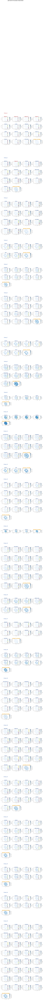

In [30]:
#@title Plot grouped genes
#CUSTOM2

#print(len(smallest_pvals))
#print(smallest_pvals)
plot_list = smallest_pvals
#plot_list = smallest_pvals[:15]
average_genes={}

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle
import seaborn as sns
import warnings
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch

def plot_genes(clustering,
               df: pd.DataFrame,
               results_df: pd.DataFrame = None,
               x_colname: str = "X",
               y_colname: str = "  Y",
               plots_per_row: int = 4,
               colormap: str = "Blues",
               vmin=None,
               vmax=None,
               take_log: bool = False,
               main_title: str = None,
               verbose:bool = True,
               ):
    """
    Plot the count distributions of a list of genes
    """

    if clustering=='hier':
      num_clusters=P
      genes=gene_dic_hier
    elif clustering=='kmean':
      num_clusters=K
      genes=gene_dic_kmean
    elif clustering=='som':
      num_clusters=Psom
      genes=gene_dic_som
    else:
      print('unrecognized clustering method...')
      return
    all_pvals = []
    num_genes = len(smallest_pvals)
    num_grps = len(genes)
    num_rows = num_genes // plots_per_row + 1

    print(
        f"Number of genes: {num_genes}\n"
        f"Number of groups: {num_clusters}\n"
        f"Number of plots per row: {plots_per_row}"
    )

    fig = plt.figure(figsize=(6 * plots_per_row, 6 * num_rows))
    fig.suptitle('gene plot of '+str(num_clusters)+' groups using '+clustering, fontsize=20, fontweight='bold')
    fig.subplots_adjust(hspace=0.4, wspace=0.4)
    #outer gridspec
    outer = gridspec.GridSpec(num_clusters,1, 
                              #wspace=0.2, hspace=0.2
                              height_ratios=[len(genes[grpidx]) for grpidx in genes.keys()]
                              )

    #df_columns = df.columns

    sns.set_style("white")

    for i, grpidx in enumerate(genes.keys()):
        #print(grpidx)
        #group average for reference plot
        if len(genes[grpidx]):
          group_average=sum([df[gene] for gene in genes[grpidx] if gene in df.columns])/len(genes[grpidx])
          average_genes['group'+str(i+1)+'_average']=group_average
          df['group'+str(i+1)+'_average']=group_average
          
          genes[grpidx].append('group'+str(i+1)+'_average')
          print(genes[grpidx])
          grp_cols=plots_per_row
          grp_rows=len(genes[grpidx]) // plots_per_row + 1
          inner = gridspec.GridSpecFromSubplotSpec(grp_rows, grp_cols, subplot_spec=outer[i], wspace=0.2, hspace=0.8)
        

        
        for gene_index, gene in enumerate(genes[grpidx]):
          if gene not in df.columns:
            warnings.warn(f"Gene {gene} not found in dataframe!")
            continue

          


          ax = plt.Subplot(fig, inner[gene_index])
          fig.add_subplot(ax)
          '''
          if gene_index==0:
            text = ax.text(0,100,'Group '+str(i+1), size=30,color='red'
                          )
          '''
          x = df[x_colname].values
          y = df[y_colname].values
          counts = df[gene].values
      
          if take_log:
              counts = np.log10(counts + 1)

          ax.scatter(
              x, y, s=10, c=counts,
              cmap=colormap,
              vmin=vmin, vmax=vmax,
              alpha=0.9,
          )

          df.plot.scatter(
              x=x_colname, y=y_colname, s=10, c=gene,
              colormap=colormap,
              vmin=vmin, vmax=vmax, alpha=0.9,
              ax=ax
          )
          if results_df is not None:

              # Get the set of p-values (1 for each length)
              # -------------------------------------------

              gene_results = results_df.loc[results_df["g"]==gene,["l","pval"]]
              gene_results.sort_values(by="l", inplace=True)

              pvals = -1 * np.log10(gene_results["pval"].values)
              #pvals = gene_results["pval"].values
              # normalize to the highest p-value
              if len(pvals):
                pvals /= np.max(pvals) 
              num_boxes = len(pvals)

              all_pvals.append([gene, pvals])
              
              y_lower, y_upper = ax.get_ylim()
              x_lower, x_upper = ax.get_xlim()
              y_span = np.abs(y_upper - y_lower)
              x_span = np.abs(x_upper - x_lower)
              y_step = y_span / num_boxes
              x_step = x_span / 20

              if verbose:
                  print(f"{gene_results}\n"
                        f"P-values:\n{pvals}"
                        f"\n y lower limit : {y_lower}, y upper limit : {y_upper}"
                        f"\n x lower limit : {x_lower}, x upper limit : {x_upper}")

              cmap = plt.cm.get_cmap('viridis')

              for box_num in range(num_boxes):
                  rect = Rectangle((x_upper, y_lower + y_step * box_num), x_step, y_step,
                                  linewidth=1, facecolor=cmap(pvals[box_num]), edgecolor="gray",
                                  clip_on=False, )
                  ax.add_patch(rect)

            # Title
            # -----
          if "blank" in gene or "Blank" in gene:
                title_colour = "r"
          elif gene=='group'+str(i+1)+'_average':
                title_colour = "orange"
          else:
              title_colour = "b"

          if gene_index==0:
            title_text='Group_'+str(i+1)+'\n\n\n\n'+gene
          else:
            title_text=gene
          
          ax.set_title(title_text,
                      fontdict={'fontsize': 20,
                                'fontweight': 'bold',
                                'color': title_colour, }
                      )
          # plt.gca().invert_yaxis()
          ax.axis('equal')
          plt.subplots_adjust(left=0.3)

    if main_title is not None:
        fig.suptitle(main_title, fontsize = 25,
                     # fontproperties={'fontsize': 25,
                     #                 'fontweight': 'bold',
                     #                 }
                     )

#    plt.show()

    return all_pvals, plt

#AP, PLT = plot_genes(plot_list, df, results_df = model_results,
dftemp=df.copy()
AP, PLT = plot_genes(
            #clustering mode 'kmean' or 'hier'(hierachy)
            'kmean', 
            dftemp, 
            results_df = model_results, 
           x_colname = "X", y_colname = "Y",
           plots_per_row = 4,
           colormap = "Blues", 
           vmin = None, vmax = None,
           take_log = True,
           verbose=False)


In [31]:
#anomaly analysis

centers, cluster_labels =run_Kmeans(n_clusters, reduced_data, False)

c2=centers[2]
c21=centers[21]
c12=centers[12]
c16=centers[16]
c14=centers[14]

def find_idx(gene):
  for i, g in enumerate(df_selected.index):
    if g==gene:
      return i

def Euclidist(d1, d2):
  return ((d1[0]-d2[0])**2+(d1[1]-d2[1])**2)**1/2

print('Analyzing KCNQ3')
print(c21, c2)
for gene in gene_dic_kmean[21]:
  g_coords=reduced_data[find_idx(gene)]
  print('genes', 'C21'+' '*20, 'C2'+' '*10)
  print(gene, Euclidist(g_coords, c21), Euclidist(g_coords, c2))

print('-'*30)

print('Analyzing NHLH1')
print(c12, c2)
for gene in gene_dic_kmean[12]:
  g_coords=reduced_data[find_idx(gene)] 
  print('genes', 'C12'+' '*20, 'C2'+' '*10)
  print(gene, Euclidist(g_coords, c12), Euclidist(g_coords, c2))

print('-'*30)

print('Analyzing Group 17')
print(c16)
for gene in gene_dic_kmean[16]:
  g_coords=reduced_data[find_idx(gene)] 
  print('genes','C16'+' '*10)
  print(gene, Euclidist(g_coords, c16))

print('-'*30)
for gene in ['ASPM','DLGAP5','CENPF','MKI67', 'TPX2']:
  g_coords=reduced_data[find_idx(gene)] 
  print('genes','C16'+' '*10)

  print(gene, Euclidist(g_coords, c16), Euclidist(g_coords,c14))


Analyzing KCNQ3
[-3.52875334  1.72157885] [-7.49188498 -1.07730065]
genes C21                     C2          
EOMES 0.003656679327208792 11.406054435425439
genes C21                     C2          
ERBIN 1.1460507256291084 20.25169100134073
genes C21                     C2          
FUT9 0.3697374173667042 12.699087998993868
genes C21                     C2          
GLI2 1.3460569926515624 13.84905113437486
genes C21                     C2          
IQSEC1 1.9180814659103305 23.157698509737685
genes C21                     C2          
LHX2 1.876933980286612 21.40693609753657
genes C21                     C2          
MEIS2 2.1515472225065255 17.767690372017114
genes C21                     C2          
MIR100HG 0.6907469731134095 13.657405330189954
genes C21                     C2          
MPPED2 1.2853402313596978 19.96010037978236
genes C21                     C2          
MSH6 0.10815938412424611 14.016946914541482
genes C21                     C2          
NTRK3 1.175080617145

IndexError: ignored

In [ ]:
#@title Plot labelled dendrogram
#=====plot result dendrogram=====
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle
import seaborn as sns
import warnings
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch


#wrapper function to plot average
def plot_average(
               gene,
               grid, 
               gridstart_vertical:int,
               gridstart_horizontal:int,
               grid_h:int,
               grid_w:int,
               df: pd.DataFrame,
               results_df: pd.DataFrame = None,
               x_colname: str = "X",
               y_colname: str = "  Y",
               plots_per_row: int = 4,
               colormap: str = "Blues",
               vmin=None,
               vmax=None,
               take_log: bool = False,
               main_title: str = None,
               verbose:bool = True,):
                

            all_pvals = []
            ax = plt.Subplot(fig, grid[gridstart_vertical: gridstart_vertical+grid_h, gridstart_horizontal:gridstart_horizontal+grid_w])
            fig.add_subplot(ax)

            x = df[x_colname].values
            y = df[y_colname].values
            counts = df[gene].values
        
            if take_log:
                counts = np.log10(counts + 1)

            ax.scatter(
                x, y, s=10, c=counts,
                cmap=colormap,
                vmin=vmin, vmax=vmax,
                alpha=0.9,
            )

            df.plot.scatter(
                x=x_colname, y=y_colname, s=10, c=gene,
                colormap=colormap,
                vmin=vmin, vmax=vmax, alpha=0.9,
                ax=ax
            )

            if results_df is not None:

                # Get the set of p-values (1 for each length)
                # -------------------------------------------

                gene_results = results_df.loc[results_df["g"]==gene,["l","pval"]]
                gene_results.sort_values(by="l", inplace=True)

                pvals = -1 * np.log10(gene_results["pval"].values)
                #pvals = gene_results["pval"].values
                # normalize to the highest p-value
                if len(pvals):
                  pvals /= np.max(pvals) 
                num_boxes = len(pvals)

                all_pvals.append([gene, pvals])
                
                y_lower, y_upper = ax.get_ylim()
                x_lower, x_upper = ax.get_xlim()
                y_span = np.abs(y_upper - y_lower)
                x_span = np.abs(x_upper - x_lower)
                y_step = y_span / num_boxes
                x_step = x_span / 20

                if verbose:
                    print(f"{gene_results}\n"
                          f"P-values:\n{pvals}"
                          f"\n y lower limit : {y_lower}, y upper limit : {y_upper}"
                          f"\n x lower limit : {x_lower}, x upper limit : {x_upper}")

                cmap = plt.cm.get_cmap('viridis')

                for box_num in range(num_boxes):
                    rect = Rectangle((x_upper, y_lower + y_step * box_num), x_step, y_step,
                                    linewidth=1, facecolor=cmap(pvals[box_num]), edgecolor="gray",
                                    clip_on=False, )
                    ax.add_patch(rect)

              # Title
              # -----


            title_colour = "b"
            title_text='Group_'+str(i+1)

            
            ax.set_title(title_text,
                        fontdict={'fontsize': 20,
                                  'fontweight': 'bold',
                                  'color': title_colour, }
                        )
            # plt.gca().invert_yaxis()
            ax.axis('equal')
            plt.subplots_adjust(left=0.3)



row_h=15
num_grp=len(average_genes)
num_cols=num_grp*row_h

fig=plt.figure(figsize=(100,60))
grid = plt.GridSpec(16,num_cols, wspace=0.4, hspace=0.3)

#dendrogram

dendro=plt.subplot(grid[0:8, 0:num_cols])
plt.title('Hierarchical Clustering Dendrogram (labelled)', fontsize=30)
dendrogram_truncated = dendrogram(linked , 
                                  leaf_rotation=90, 
                                  orientation="top", 
                                  #color_threshold=50, 
                                  truncate_mode=t_mode,
                                  leaf_label_func=llf2,
                                  p=P, 
                                  )
dendro.tick_params(axis='x', which='major', labelsize=15)
#print((dendrogram_no_truncated['ivl']))
#legend=plt.Subplot(fig, grid[num_rows:num_rows+100,0:16])
#legend.text(0,0,legendlabels, transform=plt.gcf().transFigure)
dftemp=df

#average gene labels

for i,k in enumerate(average_genes.keys()):
    plot_average(k, grid,
           gridstart_vertical=9,
           gridstart_horizontal=i*row_h,
           grid_h=2,
           grid_w=8,     
           df=dftemp, 
           results_df = model_results, 
           x_colname = "X", y_colname = "Y",
           plots_per_row = 1,
           colormap = "Blues", 
           vmin = None, vmax = None,
           take_log = True,
           verbose=False, )

plt.show()
print(legendlabels)

In [ ]:
#testing
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree

randomMatrix = np.random.uniform(-10,10,size=(10,3))
df_selected=pd.DataFrame(randomMatrix, index=[i for i in range(10)])
linked = linkage(randomMatrix, 'ward')
N=len(randomMatrix)

p = len(labels)
plt.figure(figsize=(8,4))
plt.title('Hierarchical Clustering Dendrogram (truncated)', fontsize=20)
plt.xlabel('Look at my fancy labels!', fontsize=16)
plt.ylabel('distance', fontsize=16)
print(linked)
R = dendrogram(
                linked,
                #truncate_mode='lastp',  # show only the last p merged clusters
                #p=p,  # show only the last p merged clusters
                no_plot=True,
                )

# call dendrogram to get the returned dictionary 
# (plotting parameters can be ignored at this point)

R = dendrogram(
                linked,
                truncate_mode='lastp',  # show only the last p merged clusters
                p=p,  # show only the last p merged clusters
                no_plot=True,
                )

print(R['ivl'])
print("values passed to leaf_label_func\nleaves : ", R["leaves"])

# create a label dictionary
#temp = {R["leaves"][ii]: labels[ii] for ii in range(len(R["leaves"]))}


def get_labels(idx, head):
    row=linked[idx-N]
    lidx=int(row[0])
    ridx=int(row[1])
    if lidx>=N:
      get_labels(lidx,head)
    if ridx>=N:                 
      get_labels(ridx,head)
    if lidx<N:
      label_dic[head]+=[df_selected.index.values[lidx]]
    if ridx<N:
      label_dic[head]+=[df_selected.index.values[ridx]]


label_dic={}
for idx in R["leaves"]:
  label_dic[idx]=[]
  if idx>=N:
    get_labels(idx, idx)
  else:
    label_dic[idx]=[df_selected.index.values[idx]]


def llf(xx):
    aggr_label=''
    for lbl in label_dic[xx]:
      aggr_label+=str(lbl)+' '
    return aggr_label


#def get_lastp_labels():

## This version gives you your label AND the count
# temp = {R["leaves"][ii]:(labels[ii], R["ivl"][ii]) for ii in range(len(R["leaves"]))}
# def llf(xx):
#     return "{} - {}".format(*temp[xx])

dendrogram(
            linked,
            truncate_mode='lastp',  # show only the last p merged clusters
            p=p,  # show only the last p merged clusters
            leaf_label_func=llf,
            leaf_rotation=60.,
            leaf_font_size=12.,
            show_contracted=True,  # to get a distribution impression in truncated branches
            )
plt.show()

dendrogram(
            linked,
            truncate_mode='lastp',  # show only the last p merged clusters
            p=p,  # show only the last p merged clusters
            #leaf_label_func=llf,
            leaf_rotation=60.,
            leaf_font_size=12.,
            show_contracted=True,  # to get a distribution impression in truncated branches
            )
plt.show()


'''
def plot_genes(genes: list,
               df: pd.DataFrame,
               results_df: pd.DataFrame = None,
               x_colname: str = "X",
               y_colname: str = "  Y",
               plots_per_row: int = 4,
               colormap: str = "Blues",
               vmin=None,
               vmax=None,
               take_log: bool = False,
               main_title: str = None,
               verbose:bool = True,
               ):
    """
    Plot the count distributions of a list of genes
    """
    all_pvals = []
    num_genes = len(genes)
    num_rows = len(genes) // plots_per_row + 1

    print(
        f"Number of genes: {num_genes}\n"
        f"Plots per row: {plots_per_row}\n"
        f"Number of rows: {num_rows}"
    )

    fig = plt.figure(figsize=(6 * plots_per_row, 4 * num_rows))
    fig.subplots_adjust(hspace=0.4, wspace=0.4)


    df_columns = df.columns

    sns.set_style("white")

    for gene_index, gene in enumerate(genes):

        if gene not in df_columns:
            warnings.warn(f"Gene {gene} not found in dataframe!")
            continue

        ax = fig.add_subplot(num_rows, plots_per_row, gene_index + 1)
        x = df[x_colname].values
        y = df[y_colname].values
        counts = df[gene].values
     
        if take_log:
            counts = np.log10(counts + 1)

        ax.scatter(
            x, y, s=10, c=counts,
            cmap=colormap,
            vmin=vmin, vmax=vmax,
            alpha=0.9,
        )

        df.plot.scatter(
            x=x_colname, y=y_colname, s=10, c=gene,
            colormap=colormap,
            vmin=vmin, vmax=vmax, alpha=0.9,
            ax=ax
        )

        if results_df is not None:

            # Get the set of p-values (1 for each length)
            # -------------------------------------------

            gene_results = results_df.loc[results_df["g"]==gene,["l","pval"]]
            gene_results.sort_values(by="l", inplace=True)

            pvals = -1 * np.log10(gene_results["pval"].values)
            #pvals = gene_results["pval"].values
            # normalize to the highest p-value
            pvals /= np.max(pvals)
            num_boxes = len(pvals)

            all_pvals.append([gene, pvals])
            
            y_lower, y_upper = ax.get_ylim()
            x_lower, x_upper = ax.get_xlim()
            y_span = np.abs(y_upper - y_lower)
            x_span = np.abs(x_upper - x_lower)
            y_step = y_span / num_boxes
            x_step = x_span / 20

            if verbose:
                print(f"{gene_results}\n"
                      f"P-values:\n{pvals}"
                      f"\n y lower limit : {y_lower}, y upper limit : {y_upper}"
                      f"\n x lower limit : {x_lower}, x upper limit : {x_upper}")

            cmap = plt.cm.get_cmap('viridis')

            for box_num in range(num_boxes):
                rect = Rectangle((x_upper, y_lower + y_step * box_num), x_step, y_step,
                                 linewidth=1, facecolor=cmap(pvals[box_num]), edgecolor="gray",
                                 clip_on=False, )
                ax.add_patch(rect)

        # Title
        # -----

        if "blank" in gene or "Blank" in gene:
            title_colour = "r"
        else:
            title_colour = "b"

        ax.set_title(gene,
                     fontdict={'fontsize': 20,
                               'fontweight': 'bold',
                               'color': title_colour, }
                     )
        # plt.gca().invert_yaxis()
        ax.axis('equal')

    if main_title is not None:
        fig.suptitle(main_title, fontsize = 25,
                     # fontproperties={'fontsize': 25,
                     #                 'fontweight': 'bold',
                     #                 }
                     )

#    plt.show()

    return all_pvals, plt

#AP, PLT = plot_genes(plot_list, df, results_df = model_results,
AP, PLT = plot_genes(ivl_leaves_list, df, results_df = model_results, 
           x_colname = "X", y_colname = "Y",
           plots_per_row = 9,
           colormap = "Blues", 
           vmin = None, vmax = None,
           take_log = True,
           verbose=False)

#X = model_results.iloc[:, [-1]].values
#X = AP
#plt.figure(figsize=(60, 40))
#plt.figure(figsize=(30, 20))
#plt.subplot(1,4,1)
#dendrogram = sch.dendrogram(sch.linkage([i[1] for i in AP], method='centroid', metric='euclidean'), labels=[i[0] for i in AP], leaf_rotation=0, orientation="left")
#####dendrogram = sch.dendrogram(sch.linkage([i[1] for i in AP], method='ward', metric='euclidean'), labels=[i[0] for i in AP], leaf_rotation=0, orientation="left", color_threshold=0.5)
#display(AP)
#plt.subplot(1,2,2)
#plt.show()
'''

## Extra plots

Not really needed by this is what is suggested by SpatialDE

In [ ]:
plt.figure(figsize=(6, 5), dpi=120)

#results['pval'] = results['pval'].clip(lower = results.query('pval > 0')['pval'].min() / 2)
#results['qval'] = results['qval'].clip(lower = results.query('qval > 0')['qval'].min() / 2)

plt.loglog()
plt.scatter(results["l"], results[pval_type]);
plt.gca().invert_yaxis();
plt.xlabel('Lengthscale / Period')
plt.ylabel('P-value');

for i, gene_name in enumerate(results['g']):
     plt.annotate(gene_name, (results['l'].iloc[i], results[pval_type].iloc[i]),
                  fontsize=6,
                  )

In [ ]:
plt.figure(figsize=(6, 4), dpi=120)

plt.loglog()
plt.scatter(results.max_s2_t_hat, results[pval_type]);
plt.gca().invert_yaxis();
plt.xlabel('Spatial variance component')
plt.ylabel('P-value');

In [ ]:
plt.figure(figsize=(8, 4), dpi=120)

plt.loglog()
plt.scatter(model_results.max_s2_t_hat, model_results["pval"]);
plt.gca().invert_yaxis();
plt.xlabel('Spatial variance component')
plt.ylabel('P-value');

In [ ]:
plt.figure(figsize=(8, 4), dpi=120)

plt.loglog()
plt.scatter(results.max_s2_t_hat, results.qval);
plt.gca().invert_yaxis();
plt.xlabel('Spatial variance component')
plt.ylabel('Q-value');

In [ ]:
plt.figure(figsize=(8, 4), dpi=120)

plt.loglog()
plt.scatter(1./results.max_delta, results.qval);
plt.gca().invert_yaxis();
plt.xlabel('SNR')
plt.ylabel('Q-value');

In [ ]:
plt.figure(figsize=(8, 4), dpi=120)

print(results.query('qval < 0.05').shape)

plt.hist(results.query(f'{pval_type} < 1.')[pval_type], bins=200, color='w', ec='k');
plt.title('P-Value Histogram')
plt.ylabel('# Genes')
plt.xlabel('P-value');